In [1]:
!7z x human.zip


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.30GHz (306F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan         1 file, 6455227 bytes (6304 KiB)

Extracting archive: human.zip
--
Path = human.zip
Type = zip
Physical Size = 6455227

  0%    Everything is Ok

Files: 20
Size:       6530625
Compressed: 6455227


In [2]:
!7z x dalle.zip


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.30GHz (306F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan         1 file, 32555899 bytes (32 MiB)

Extracting archive: dalle.zip
--
Path = dalle.zip
Type = zip
Physical Size = 32555899

  0%     48% 10 - dalle/flag dalle.png                              Everything is Ok

Files: 20
Size:       32603510
Compressed: 32555899


In [3]:
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import sobel
import cv2
from scipy import stats


dalle_folder_path = '/content/dalle'
human_folder_path = '/content/human'

In [4]:
# Helper functions for analysis
def calculate_saturation(image):
    hsv_image = image.convert('HSV')
    h, s, v = hsv_image.split()
    saturation = np.mean(np.array(s))
    return saturation

def calculate_edge_sharpness(image):
    gray_image = image.convert('L')
    image_array = np.array(gray_image, dtype=float)
    dx = sobel(image_array, axis=0, mode='constant')
    dy = sobel(image_array, axis=1, mode='constant')
    mag = np.hypot(dx, dy)
    sharpness = np.mean(mag)
    return sharpness

def calculate_texture_details(image):
    gray_image = image.convert('L')
    texture = np.std(np.array(gray_image))
    return texture



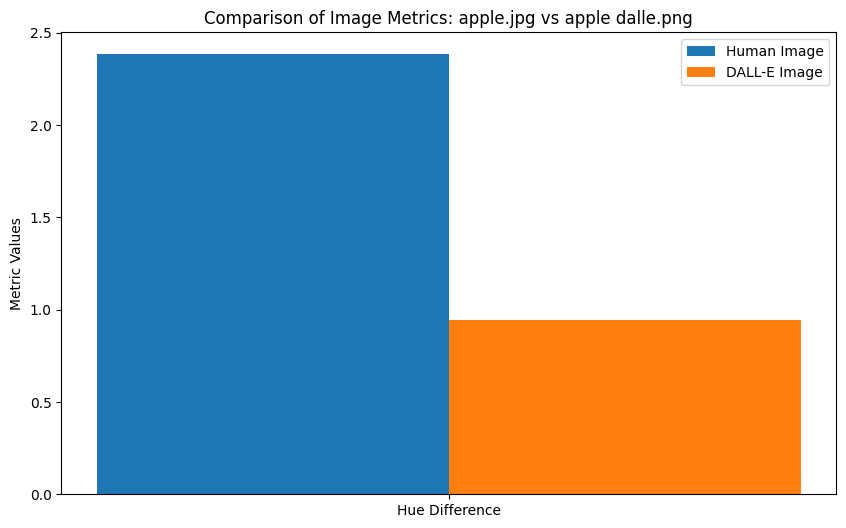

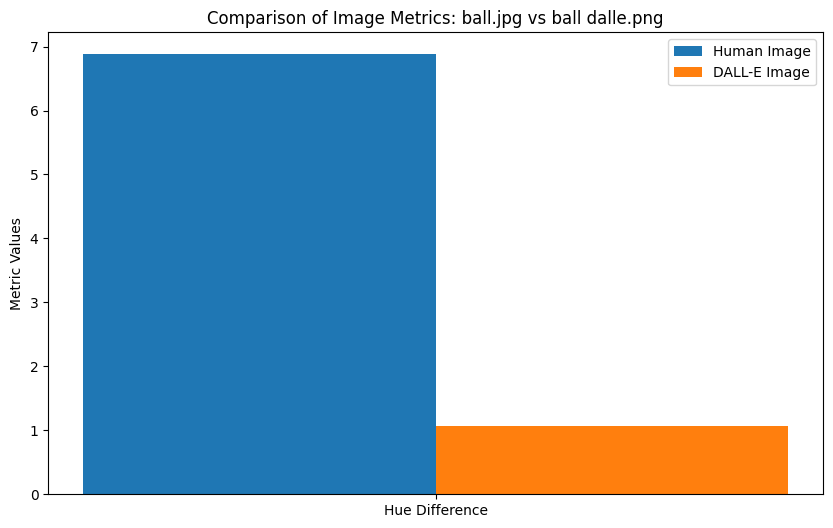

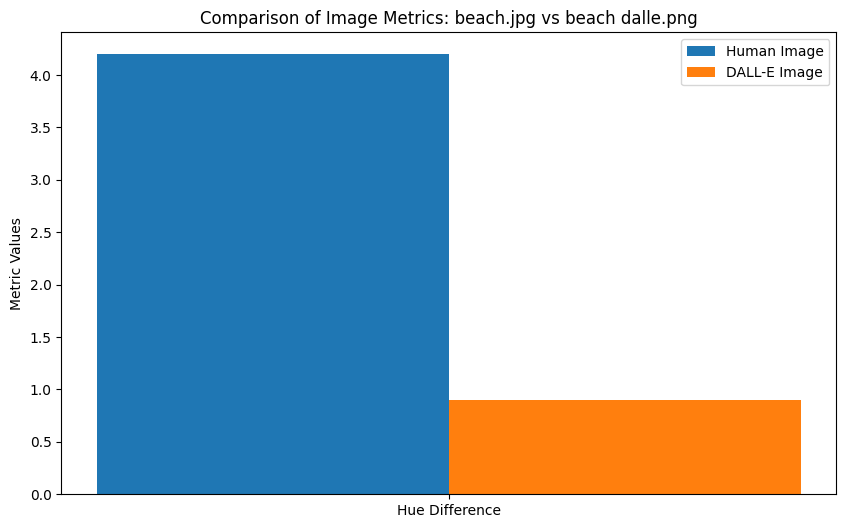

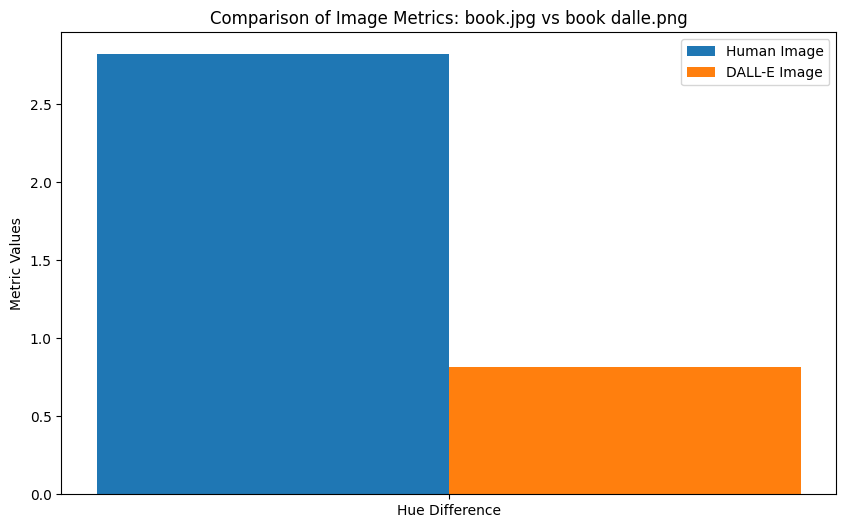

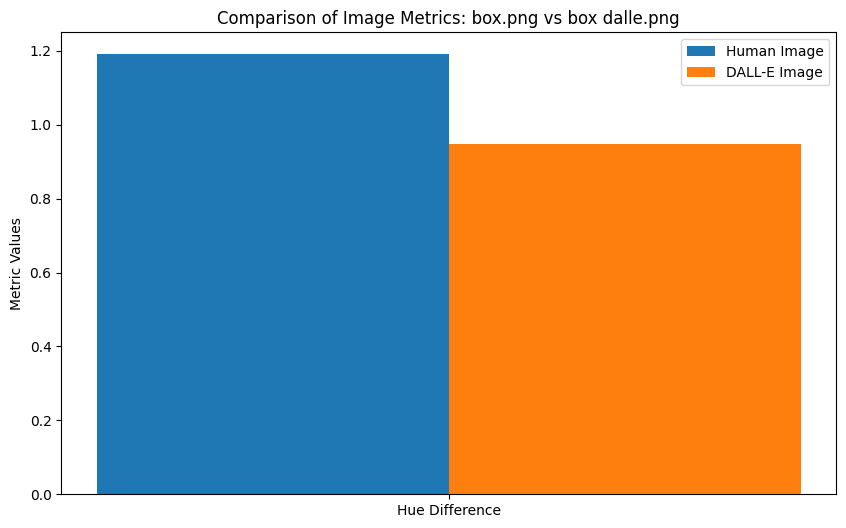

...

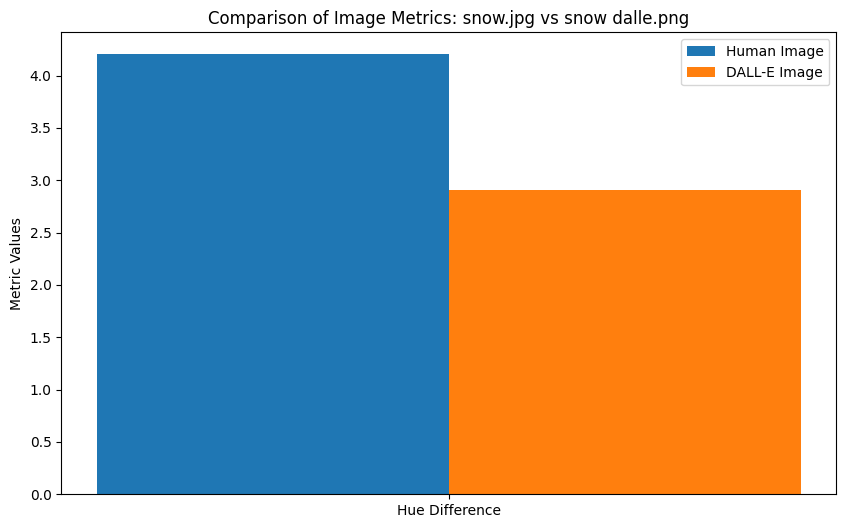

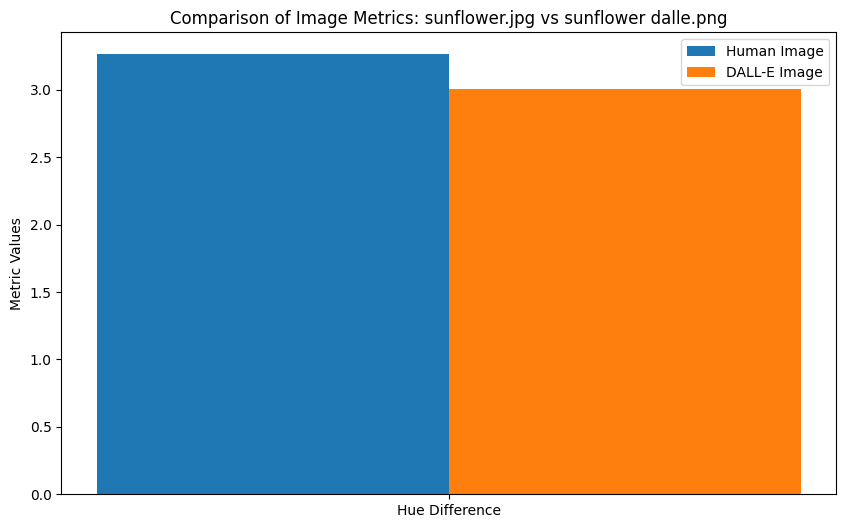

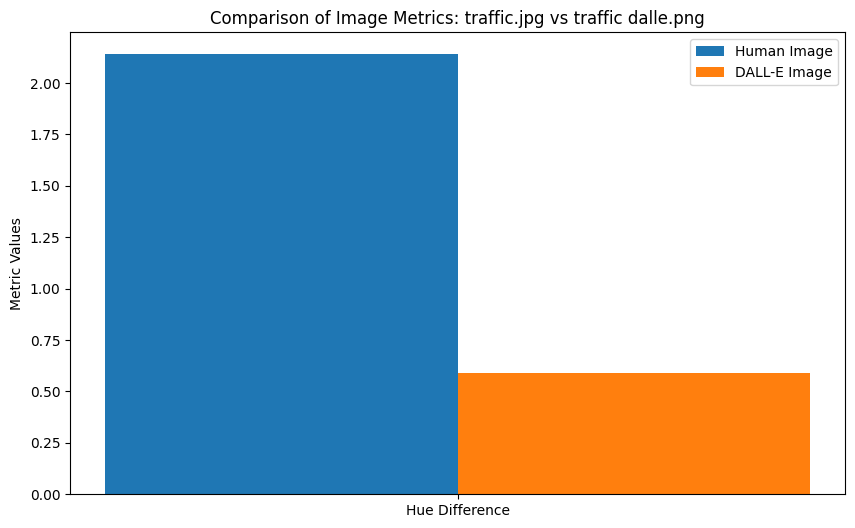

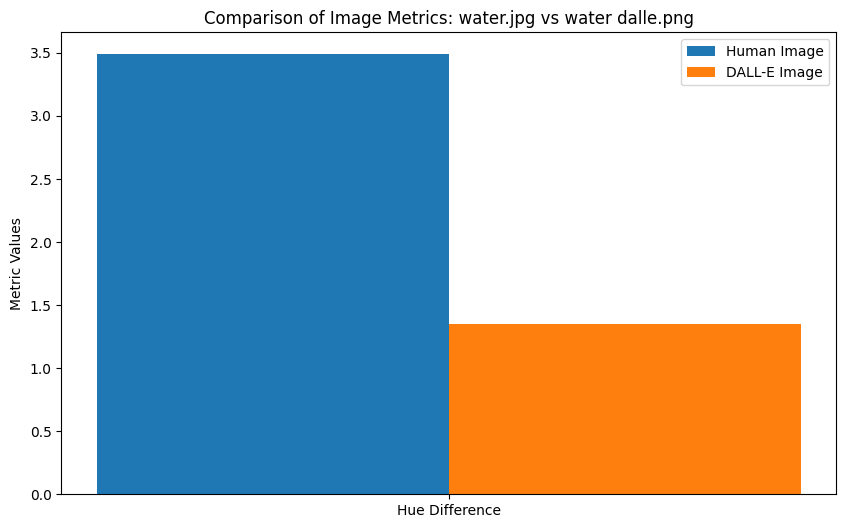

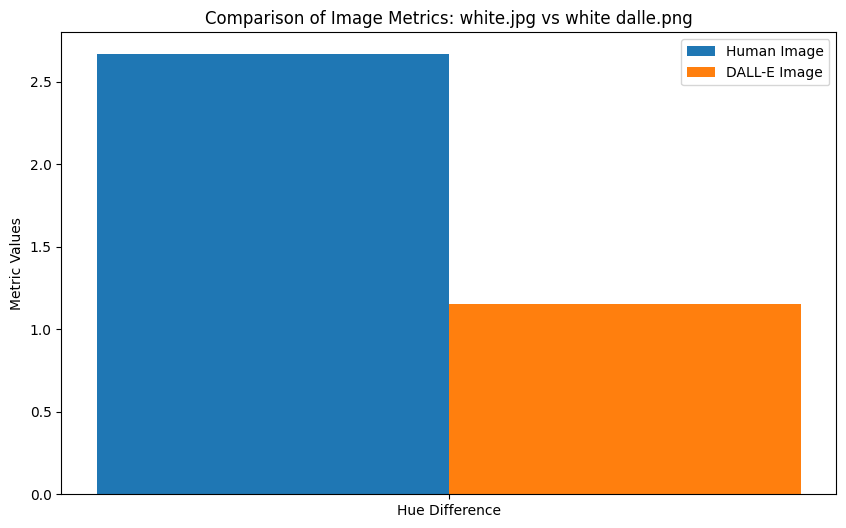

In [5]:

# Function to calculate the difference in hue channel after applying bilateral filtering
def calculate_hue_difference_index(image_path):
    image = Image.open(image_path).convert("RGB")
    image_cv = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
    hsv_original = cv2.cvtColor(image_cv, cv2.COLOR_BGR2HSV)
    filtered_image = cv2.bilateralFilter(image_cv, 9, 75, 75)
    hsv_filtered = cv2.cvtColor(filtered_image, cv2.COLOR_BGR2HSV)
    hue_difference = hsv_original[:, :, 0].astype('int16') - hsv_filtered[:, :, 0].astype('int16')
    mean_difference = np.mean(np.abs(hue_difference))
    return mean_difference


# Function to pair images
def pair_images(human_folder, dalle_folder):
    human_images = sorted(os.listdir(human_folder))
    dalle_images = sorted(os.listdir(dalle_folder))

    paired_images = []
    for hi in human_images:
        base_name = hi.split('.')[0]
        for di in dalle_images:
            if base_name in di:
                paired_images.append((os.path.join(human_folder, hi), os.path.join(dalle_folder, di)))
                break
    return paired_images

# Function to plot the comparison of metrics
def plot_metrics_comparison(metrics, human_img_name, dalle_img_name):
    categories = list(metrics['Human Image'].keys())
    human_values = [metrics['Human Image'][category] for category in categories]
    dalle_values = [metrics['DALL-E Image'][category] for category in categories]

    x = np.arange(len(categories))
    width = 0.35

    plt.figure(figsize=(10, 6))
    plt.bar(x - width/2, human_values, width, label='Human Image')
    plt.bar(x + width/2, dalle_values, width, label='DALL-E Image')

    plt.ylabel('Metric Values')
    plt.title(f'Comparison of Image Metrics: {human_img_name} vs {dalle_img_name}')
    plt.xticks(x, categories)
    plt.legend()

    plt.show()


# Pairing images
paired_images = pair_images(human_folder_path, dalle_folder_path)

# Iterate over each pair and perform analysis
for human_img_path, dalle_img_path in paired_images:
    human_img = Image.open(human_img_path)
    dalle_img = Image.open(dalle_img_path)

    # Calculate metrics for both images
    human_hue_diff = calculate_hue_difference_index(human_img_path)
    dalle_hue_diff = calculate_hue_difference_index(dalle_img_path)


    metrics = {


        'Human Image': {'Hue Difference': human_hue_diff},
        'DALL-E Image': {'Hue Difference': dalle_hue_diff}
      }


    # Plotting the metrics comparison
    human_img_name = os.path.basename(human_img_path)
    dalle_img_name = os.path.basename(dalle_img_path)
    plot_metrics_comparison(metrics, human_img_name, dalle_img_name)



Metrics for apple.jpg vs apple dalle.png:
{'DALL-E Image': {'Saturation': 190.52844524383545, 'Sharpness': 37.156523479753524, 'Texture': 54.26178473011663}, 'Real Image': {'Saturation': 166.705023988006, 'Sharpness': 17.50666595264075, 'Texture': 68.83747615249231}}


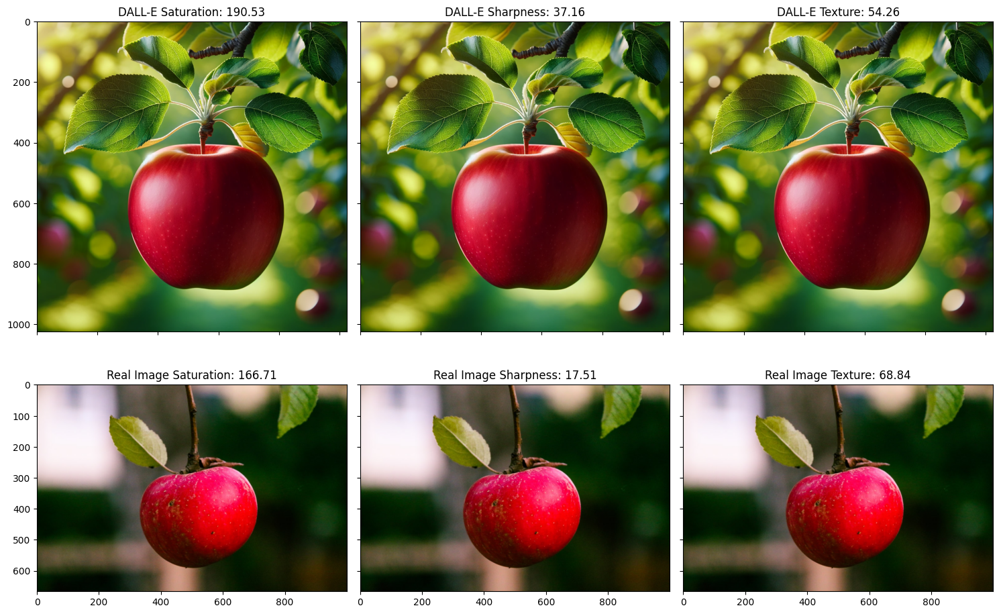

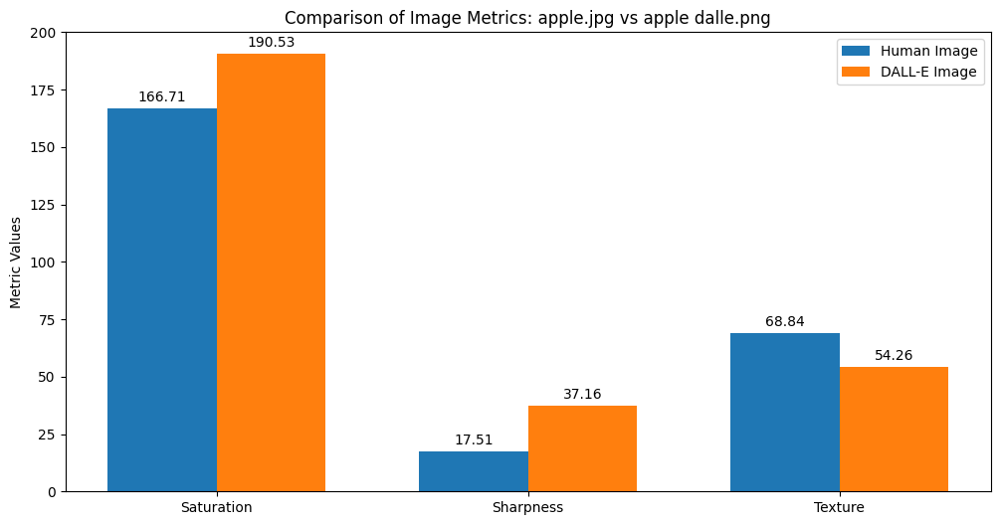

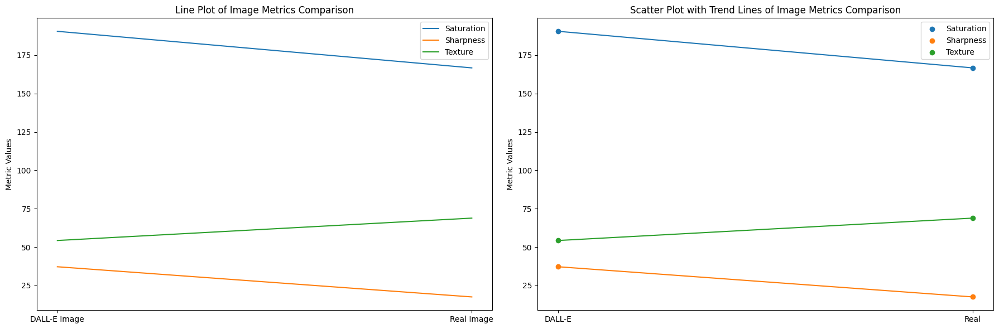

/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:523: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)



{'Saturation': {'t-statistic': 2514636353682281.5, 'p-value': 2.276009981461745e-267}, 'Sharpness': {'t-statistic': 7420538971265189.0, 'p-value': 7.904774291387117e-276}, 'Texture': {'t-statistic': -inf, 'p-value': 0.0}}


Metrics for ball.jpg vs ball dalle.png:
{'DALL-E Image': {'Saturation': 126.54413890838623, 'Sharpness': 52.73345037170119, 'Texture': 65.0247663036731}, 'Real Image': {'Saturation': 42.329140625, 'Sharpness': 55.11920374660189, 'Texture': 79.60825295456083}}


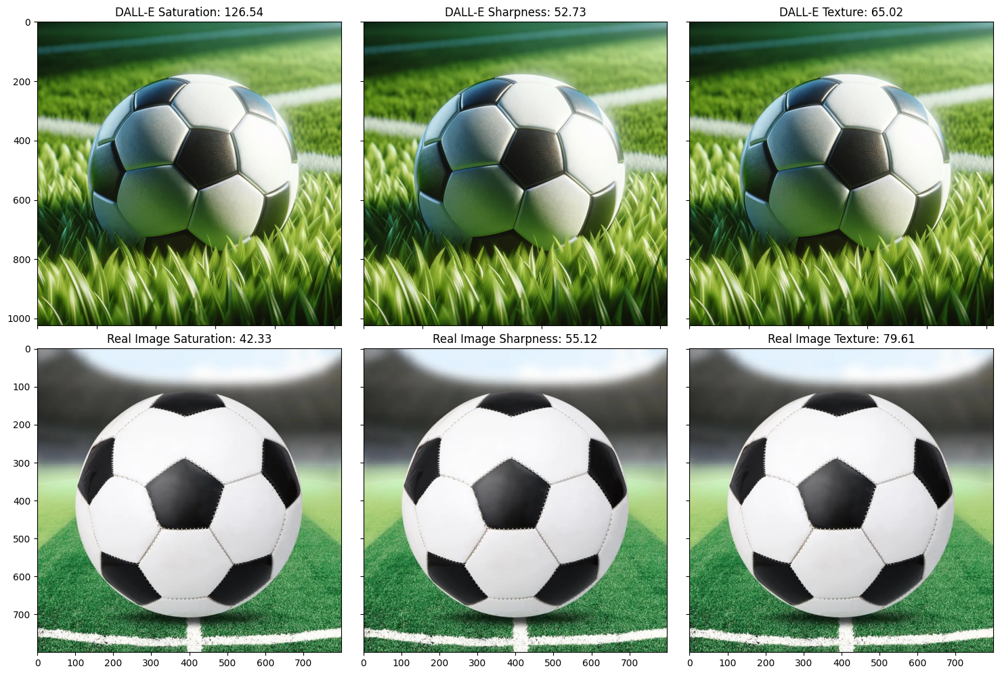

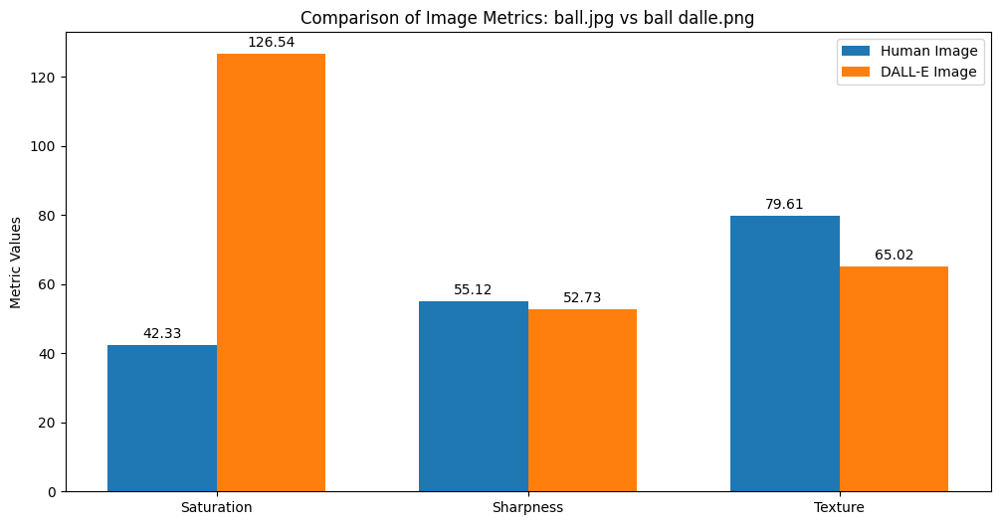

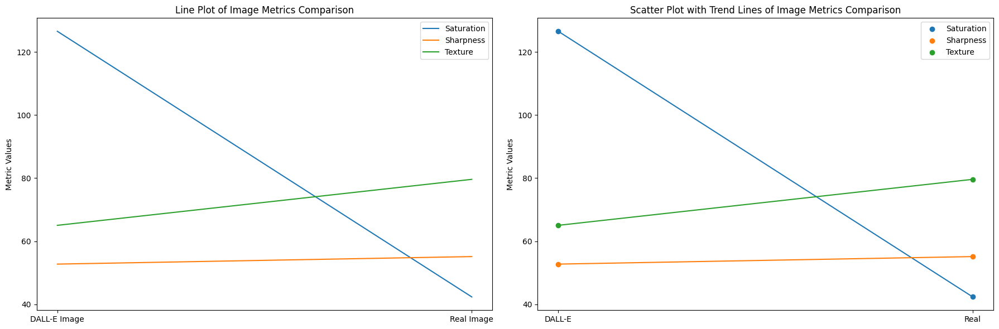


{'Saturation': {'t-statistic': 3.555662202075611e+16, 'p-value': 4.458190965367532e-288}, 'Sharpness': {'t-statistic': -1007294813456312.9, 'p-value': 3.22781635966691e-260}, 'Texture': {'t-statistic': -inf, 'p-value': 0.0}}


Metrics for beach.jpg vs beach dalle.png:
{'DALL-E Image': {'Saturation': 124.49995231628418, 'Sharpness': 52.46258777775096, 'Texture': 57.840989253925244}, 'Real Image': {'Saturation': 62.39590563970549, 'Sharpness': 69.56441402300568, 'Texture': 53.05967580660573}}


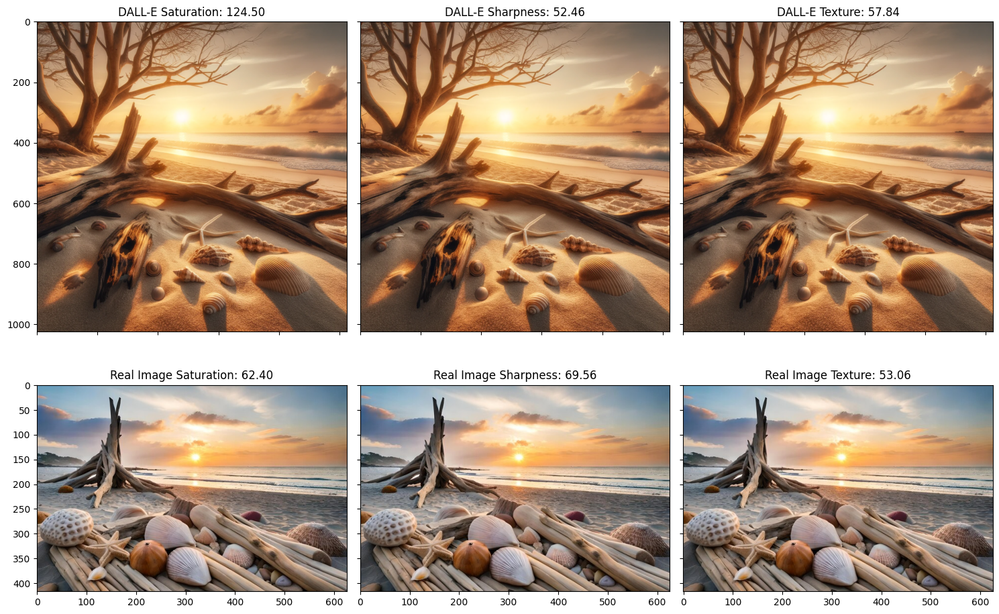

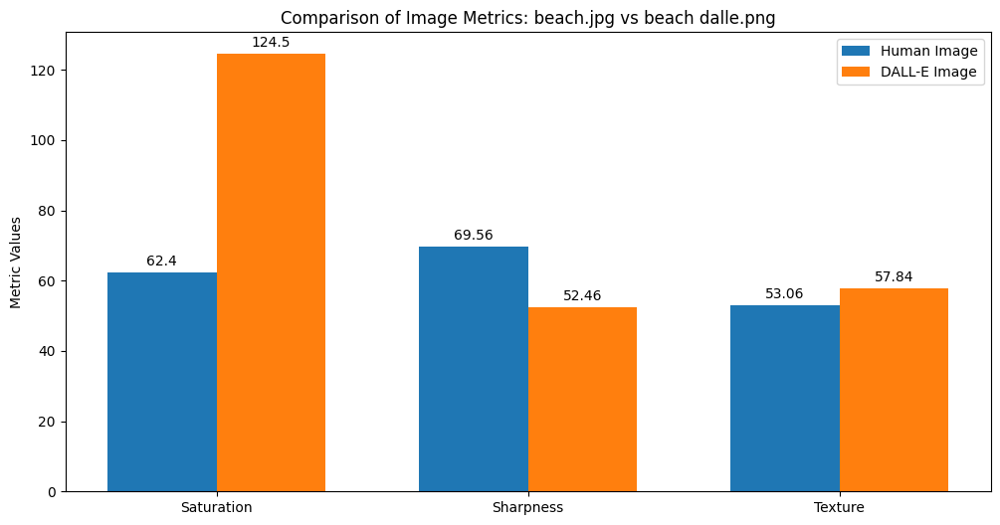

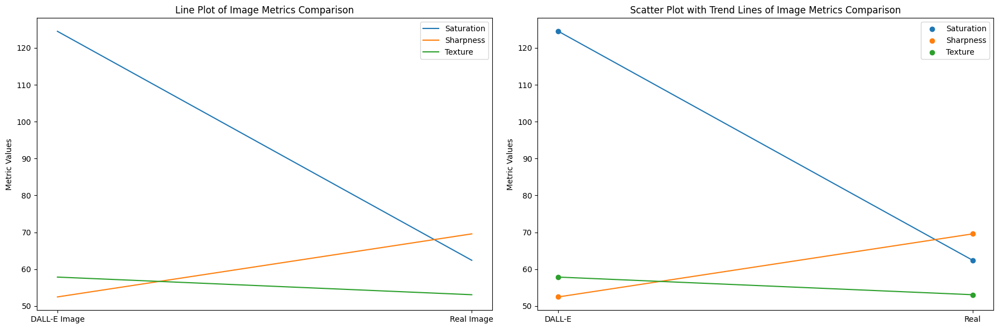


{'Saturation': {'t-statistic': 2.622110263789122e+16, 'p-value': 1.0715451368819623e-285}, 'Sharpness': {'t-statistic': -3229152373181743.0, 'p-value': 2.524258843936084e-269}, 'Texture': {'t-statistic': 2018730136845911.8, 'p-value': 1.186639448123291e-265}}


Metrics for book.jpg vs book dalle.png:
{'DALL-E Image': {'Saturation': 103.5056734085083, 'Sharpness': 22.445758843532353, 'Texture': 78.0017700075031}, 'Real Image': {'Saturation': 52.52202682563338, 'Sharpness': 50.382339740381326, 'Texture': 33.94666461440677}}


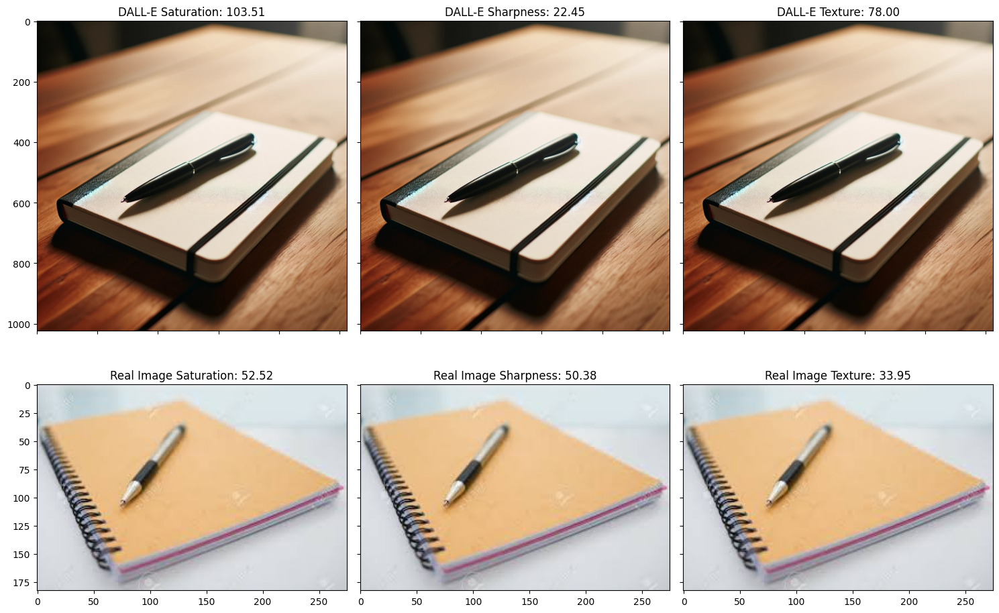

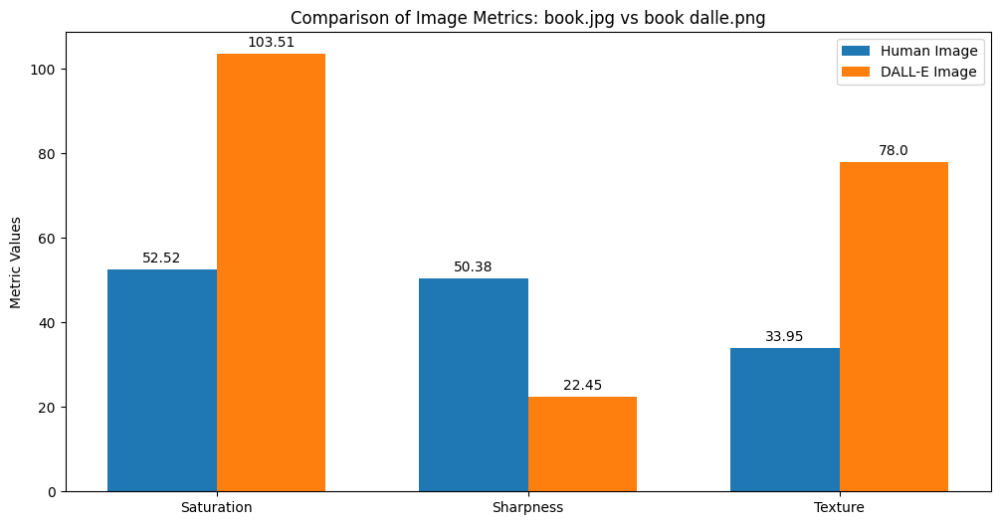

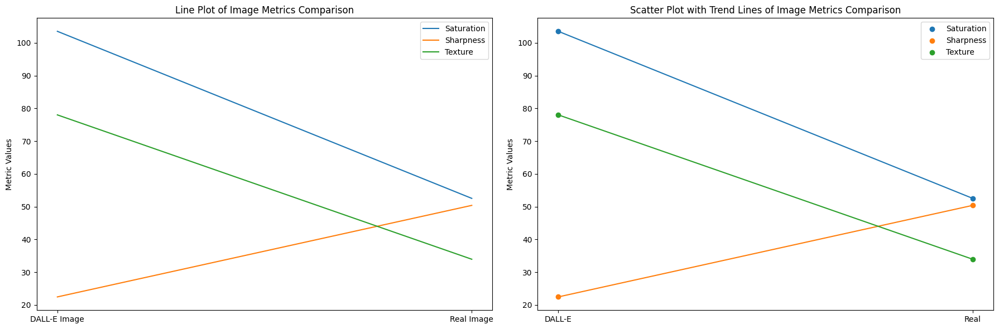


{'Saturation': {'t-statistic': inf, 'p-value': 0.0}, 'Sharpness': {'t-statistic': -inf, 'p-value': 0.0}, 'Texture': {'t-statistic': inf, 'p-value': 0.0}}


Metrics for box.png vs box dalle.png:
{'DALL-E Image': {'Saturation': 139.78861331939697, 'Sharpness': 36.735569069271804, 'Texture': 64.38514866387955}, 'Real Image': {'Saturation': 67.37126659734443, 'Sharpness': 19.82135381065809, 'Texture': 70.70323356216139}}


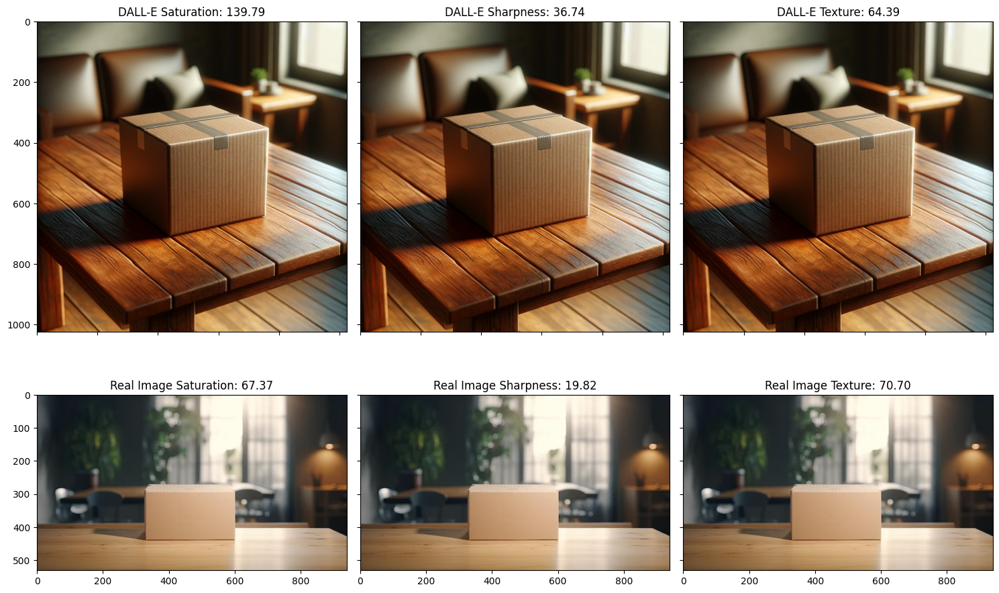

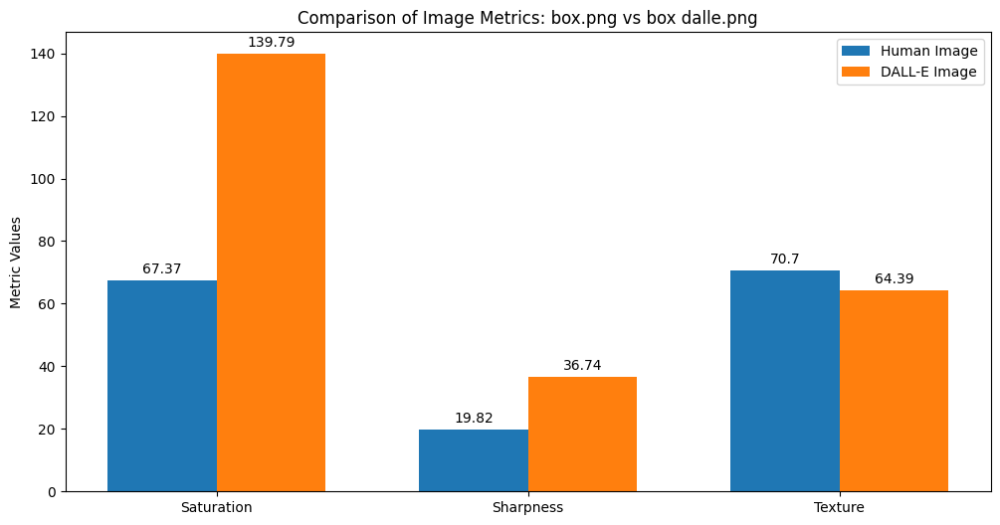

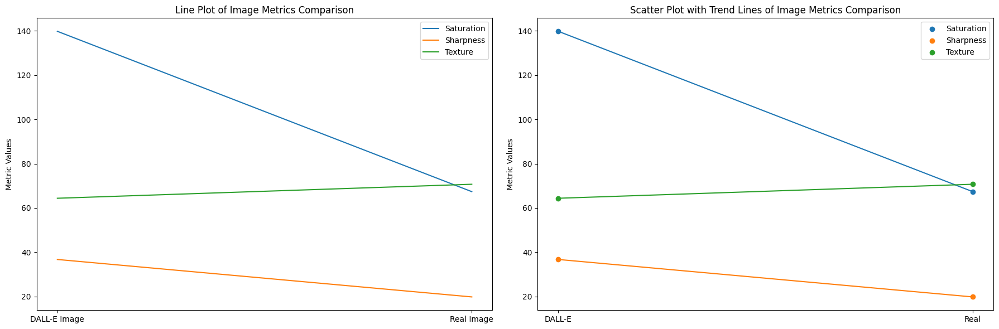


{'Saturation': {'t-statistic': inf, 'p-value': 0.0}, 'Sharpness': {'t-statistic': 7141392518995979.0, 'p-value': 1.5762870287547727e-275}, 'Texture': {'t-statistic': -1333787099699867.8, 'p-value': 2.061438349313698e-262}}


Metrics for bus.jpg vs bus dalle.png:
{'DALL-E Image': {'Saturation': 74.91872119903564, 'Sharpness': 78.39326299645509, 'Texture': 94.5171786845556}, 'Real Image': {'Saturation': 68.8895943959554, 'Sharpness': 41.71049320445884, 'Texture': 68.38204707262938}}


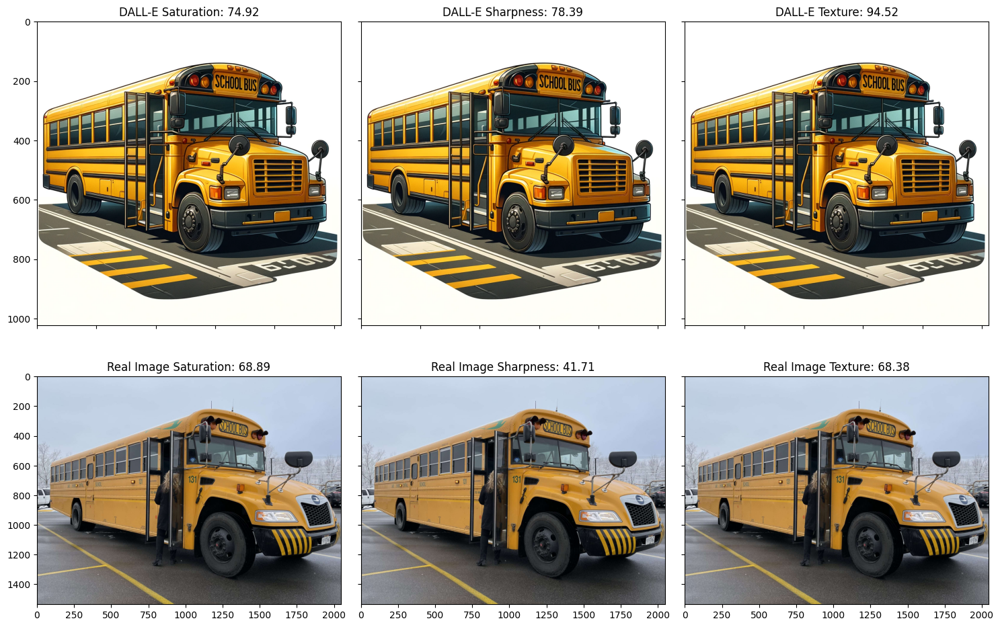

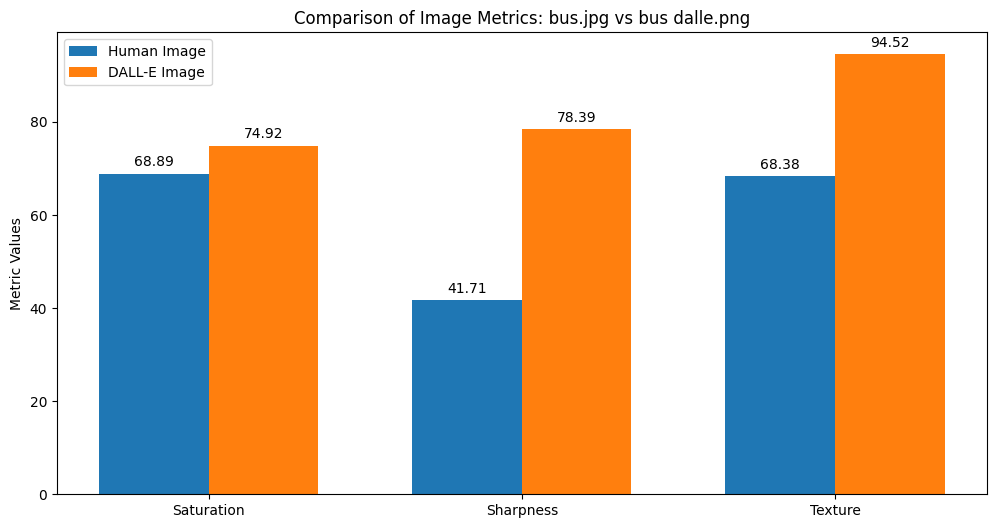

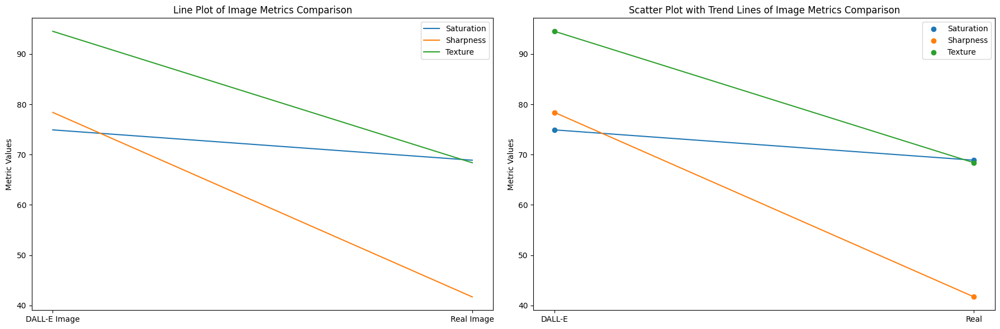


{'Saturation': {'t-statistic': 1272786244861949.8, 'p-value': 4.787723497872991e-262}, 'Sharpness': {'t-statistic': inf, 'p-value': 0.0}, 'Texture': {'t-statistic': inf, 'p-value': 0.0}}


Metrics for cake.jpg vs cake dalle.png:
{'DALL-E Image': {'Saturation': 111.00668334960938, 'Sharpness': 51.59661278473256, 'Texture': 62.570612783862714}, 'Real Image': {'Saturation': 119.81250746681641, 'Sharpness': 21.620069009225965, 'Texture': 62.861552692041}}


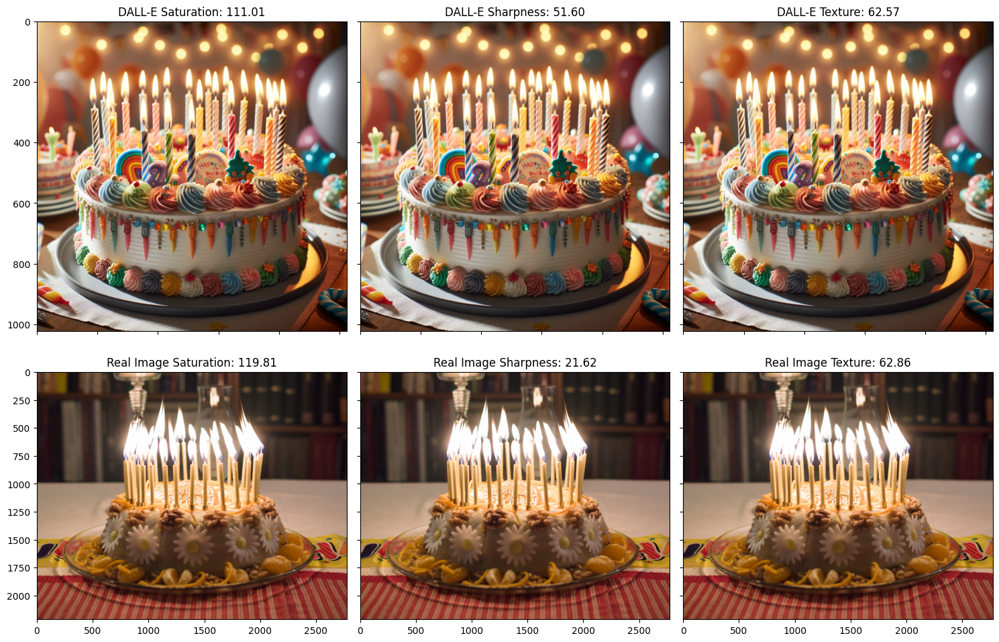

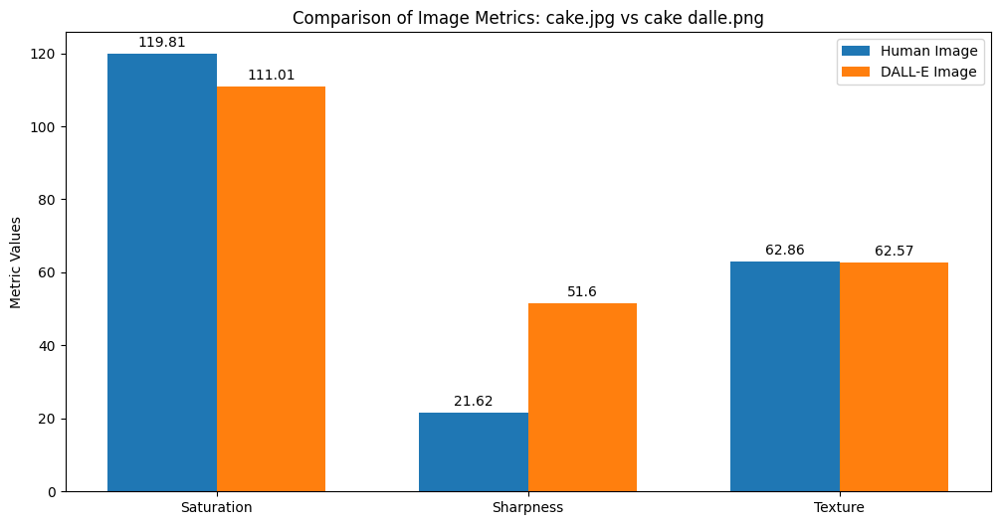

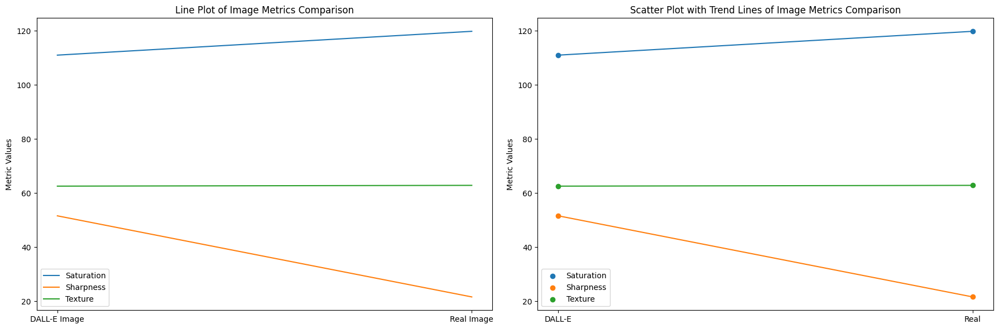


{'Saturation': {'t-statistic': -inf, 'p-value': 0.0}, 'Sharpness': {'t-statistic': inf, 'p-value': 0.0}, 'Texture': {'t-statistic': -54935027492038.11, 'p-value': 1.7719005665836146e-237}}


Metrics for cat.jpg vs cat dalle.png:
{'DALL-E Image': {'Saturation': 137.48602485656738, 'Sharpness': 15.737249054207822, 'Texture': 67.93340305352463}, 'Real Image': {'Saturation': 70.71646121841594, 'Sharpness': 9.550965090543793, 'Texture': 46.76041116781894}}


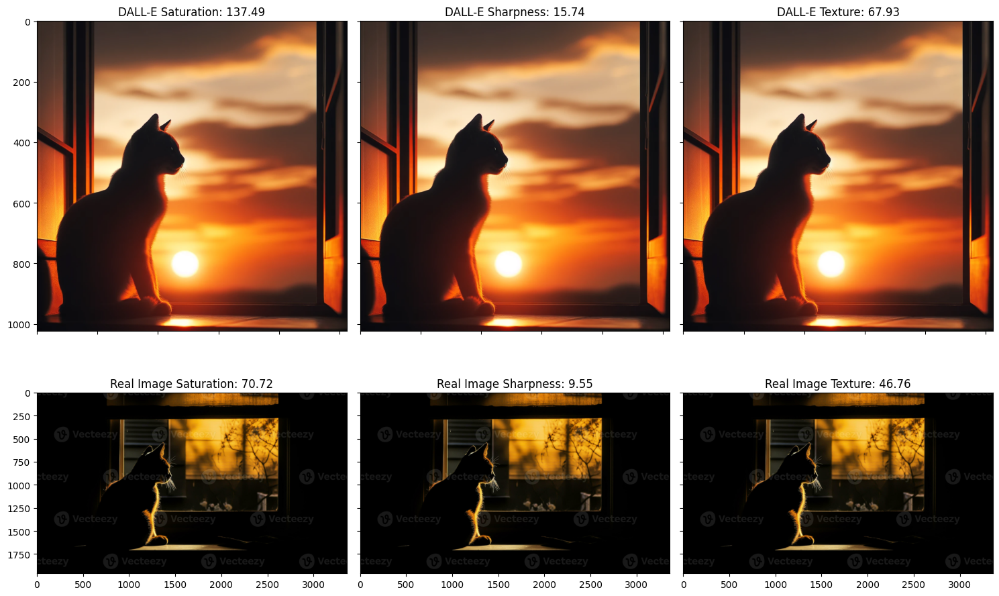

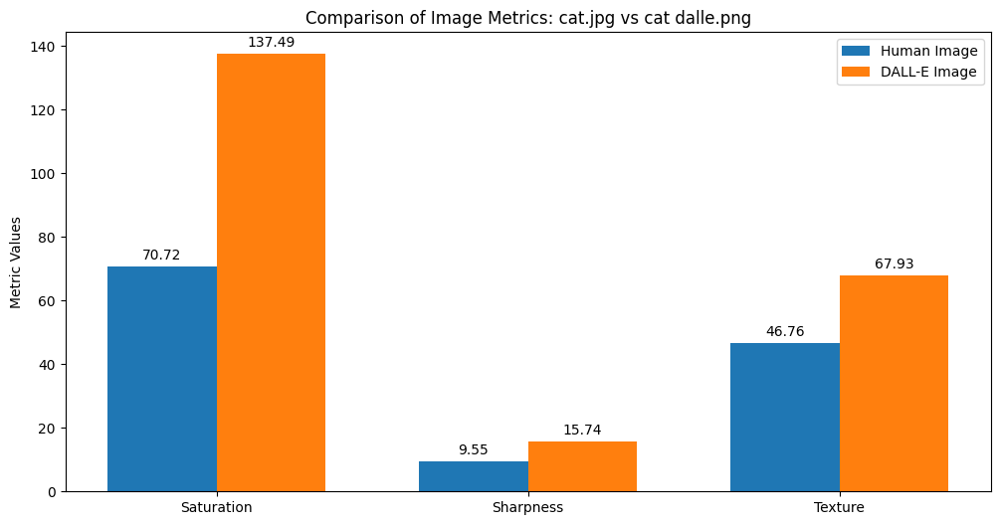

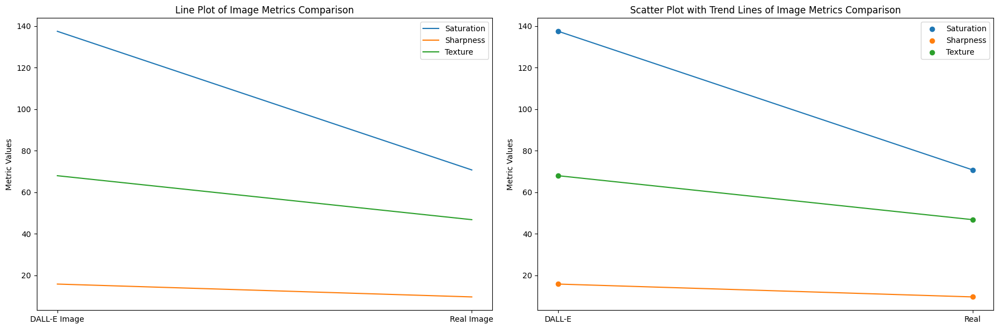


{'Saturation': {'t-statistic': inf, 'p-value': 0.0}, 'Sharpness': {'t-statistic': 4672355631723191.0, 'p-value': 3.266491525915475e-272}, 'Texture': {'t-statistic': 3997866427514155.0, 'p-value': 5.405284301139997e-271}}


Metrics for classic.jpg vs classic dalle.png:
{'DALL-E Image': {'Saturation': 92.52733707427979, 'Sharpness': 63.69609008281374, 'Texture': 65.06801474017506}, 'Real Image': {'Saturation': 148.31189269746648, 'Sharpness': 95.13019966458027, 'Texture': 42.08881873510228}}


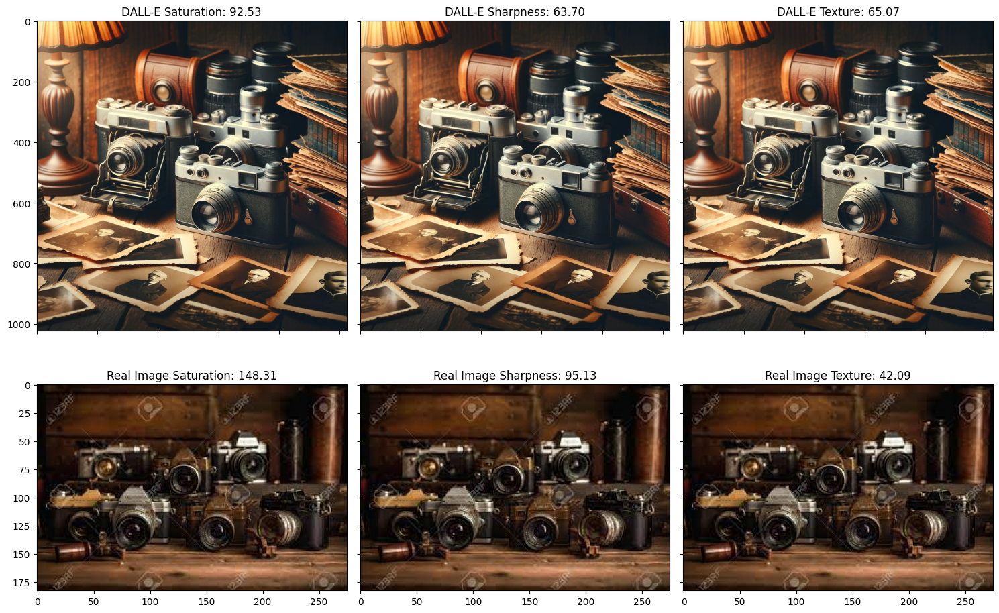

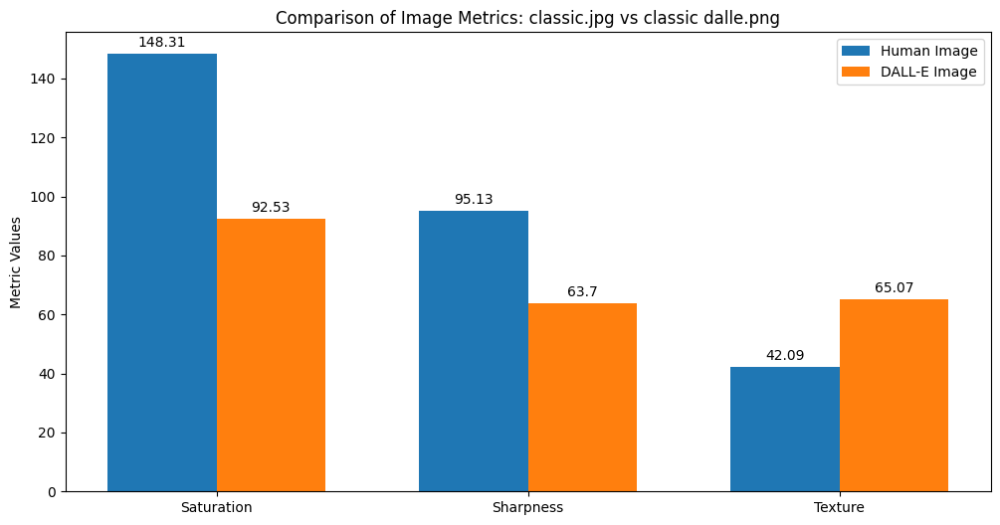

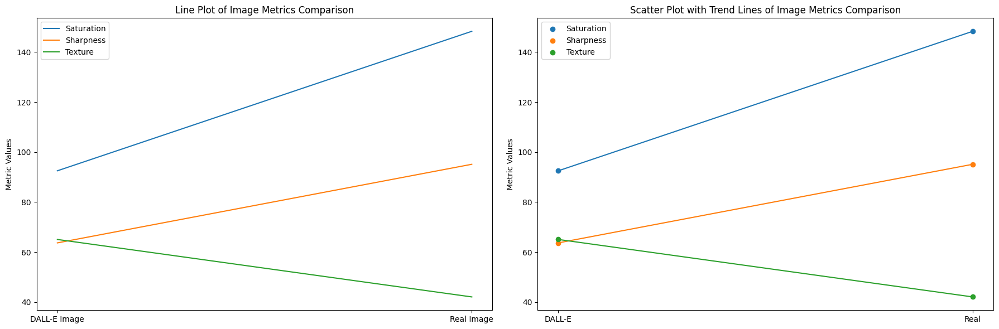


{'Saturation': {'t-statistic': -inf, 'p-value': 0.0}, 'Sharpness': {'t-statistic': -6635936446835954.0, 'p-value': 5.908641670799208e-275}, 'Texture': {'t-statistic': inf, 'p-value': 0.0}}


Metrics for coffee.jpg vs coffee dalle.png:
{'DALL-E Image': {'Saturation': 55.77700328826904, 'Sharpness': 28.835336630707836, 'Texture': 64.12905006368939}, 'Real Image': {'Saturation': 92.74721481481481, 'Sharpness': 16.628223781423745, 'Texture': 58.884317637867824}}


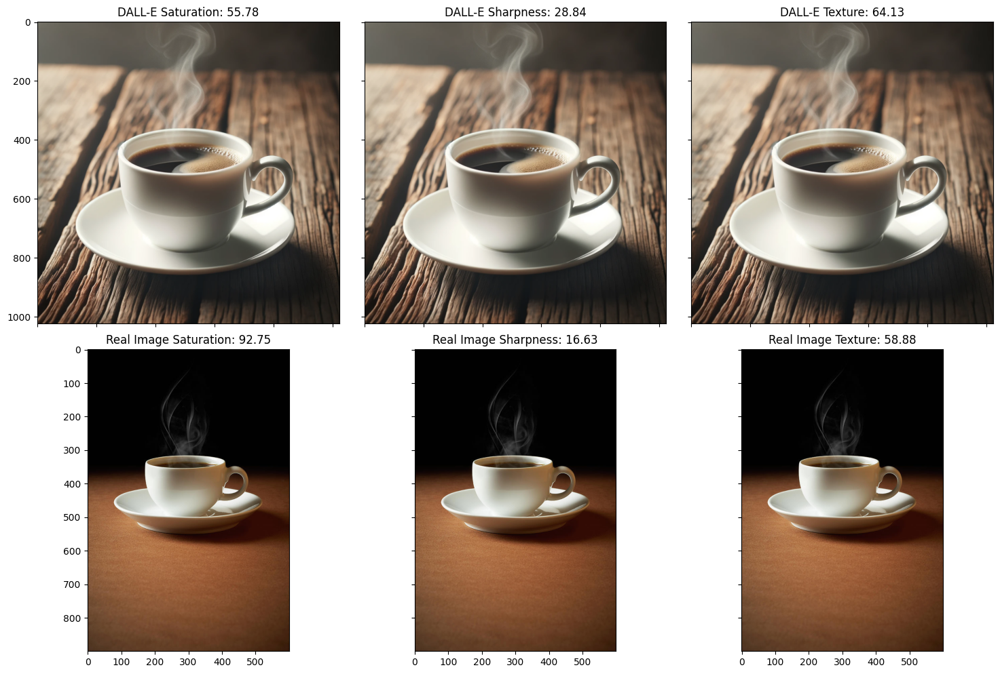

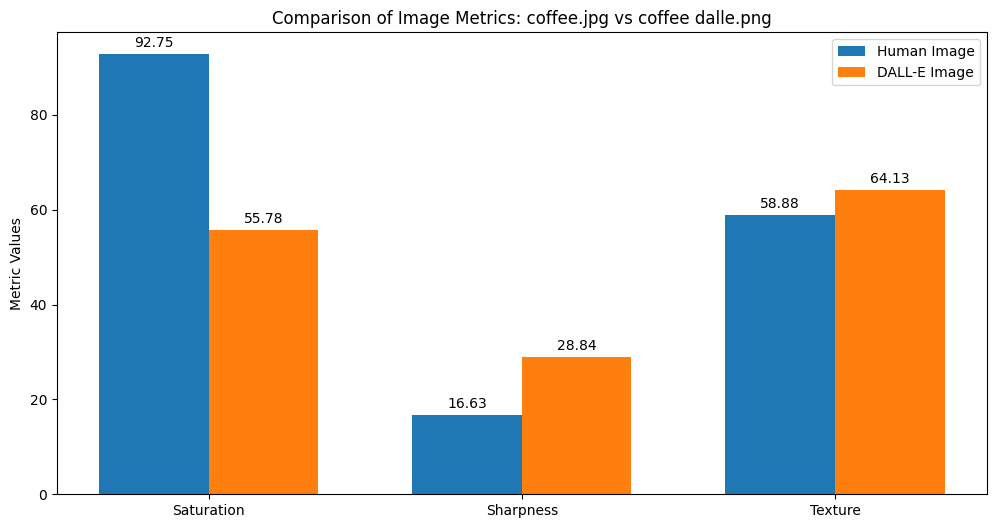

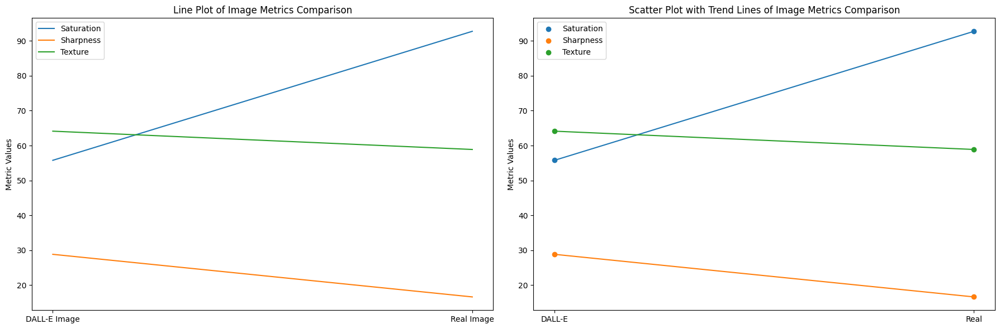


{'Saturation': {'t-statistic': -inf, 'p-value': 0.0}, 'Sharpness': {'t-statistic': inf, 'p-value': 0.0}, 'Texture': {'t-statistic': 2214391406117618.8, 'p-value': 2.244649866173569e-266}}


Metrics for flag.jpg vs flag dalle.png:
{'DALL-E Image': {'Saturation': 74.72091770172119, 'Sharpness': 25.46033995133373, 'Texture': 51.62318267959443}, 'Real Image': {'Saturation': 85.60487017223382, 'Sharpness': 22.678980168145163, 'Texture': 64.12912722914439}}


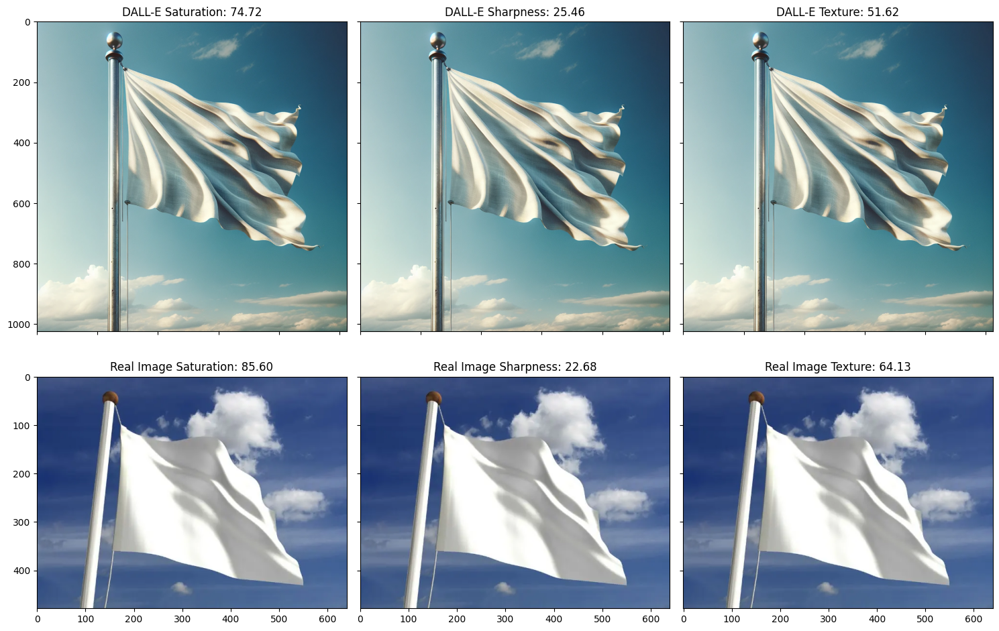

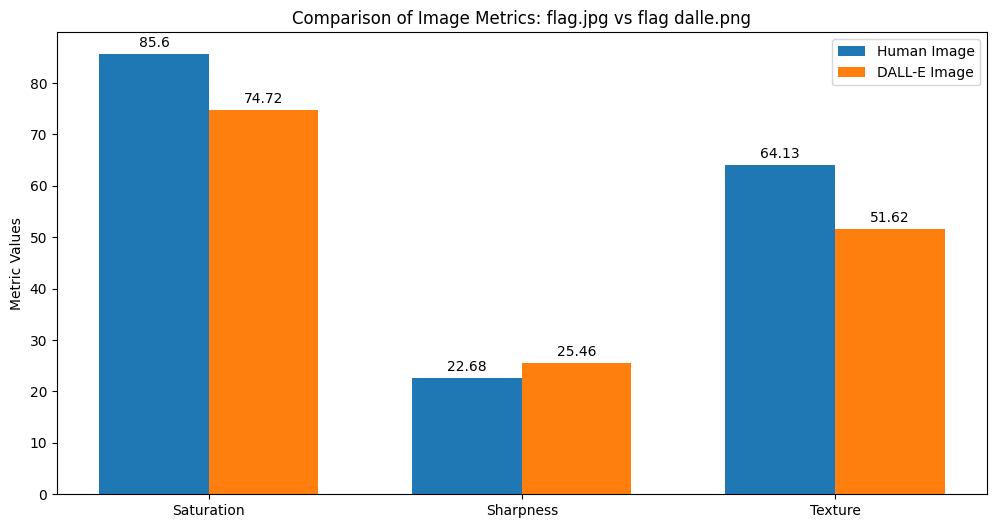

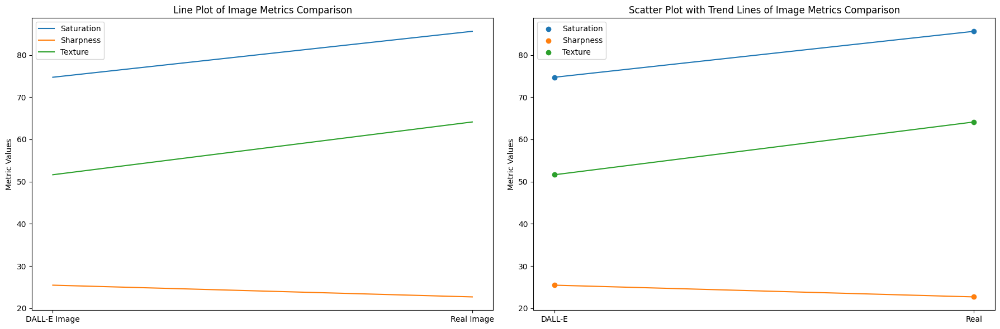


{'Saturation': {'t-statistic': -2297670201118073.5, 'p-value': 1.1549126156319128e-266}, 'Sharpness': {'t-statistic': inf, 'p-value': 0.0}, 'Texture': {'t-statistic': -5280165676243997.0, 'p-value': 3.614695220575066e-273}}


Metrics for fruits.jpg vs fruits dalle.png:
{'DALL-E Image': {'Saturation': 133.1237335205078, 'Sharpness': 58.49885094539794, 'Texture': 70.6164440124401}, 'Real Image': {'Saturation': 138.49226666666667, 'Sharpness': 114.06262209177495, 'Texture': 61.26799529482664}}


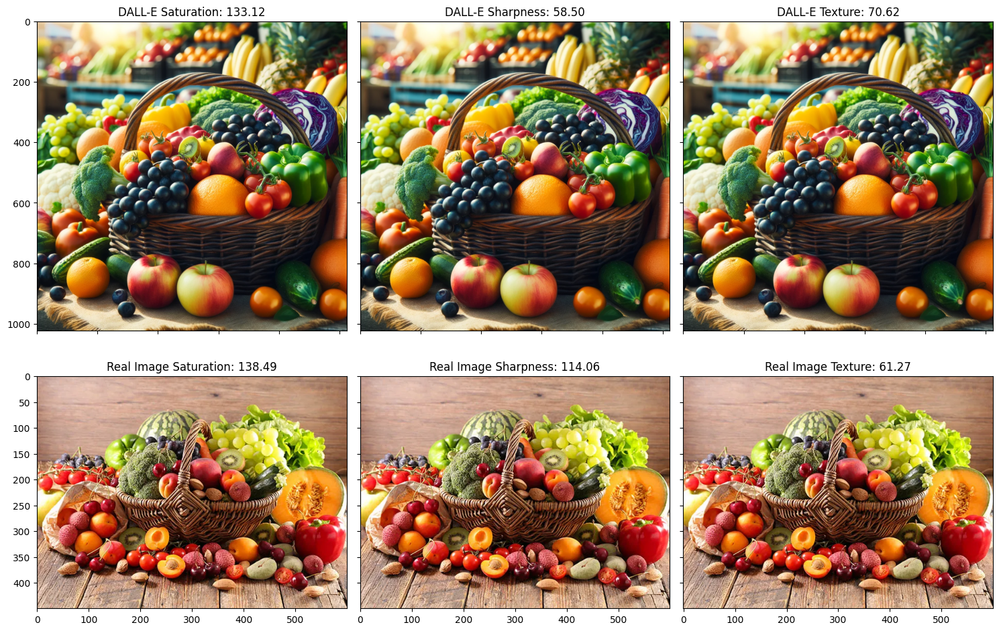

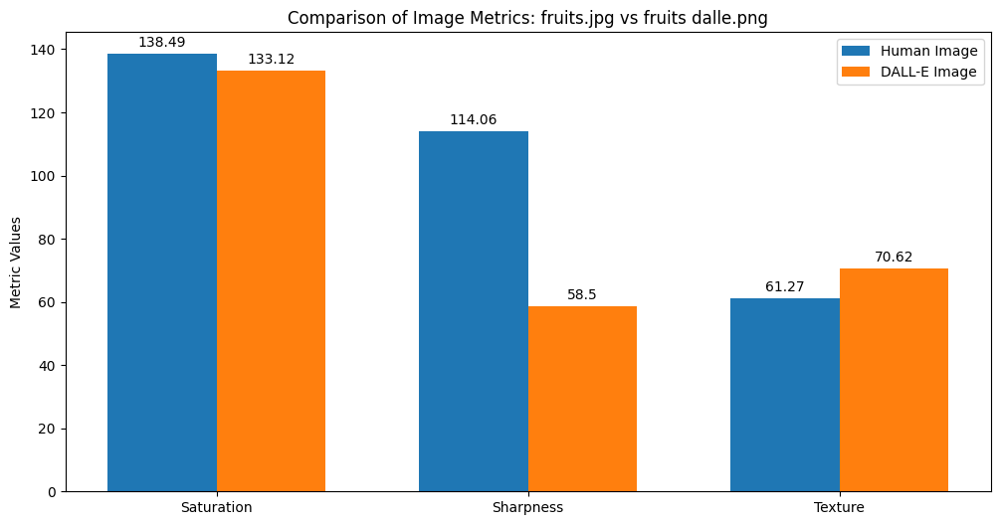

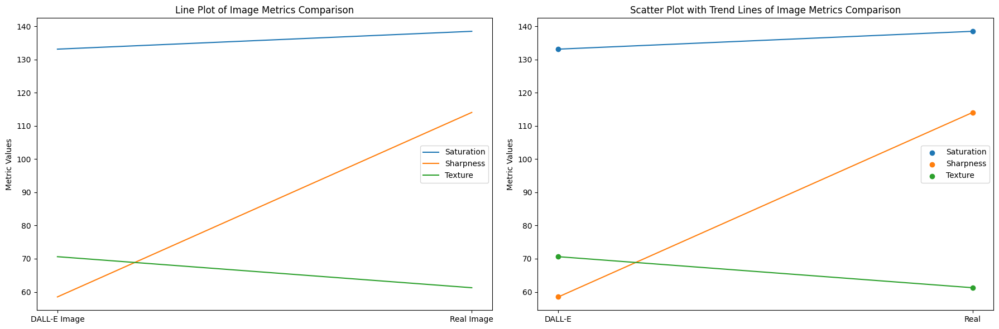


{'Saturation': {'t-statistic': -inf, 'p-value': 0.0}, 'Sharpness': {'t-statistic': -inf, 'p-value': 0.0}, 'Texture': {'t-statistic': inf, 'p-value': 0.0}}


Metrics for headphone.jpg vs headphone dalle.png:
{'DALL-E Image': {'Saturation': 100.56648581368583, 'Sharpness': 31.344924060414634, 'Texture': 76.3771577782168}, 'Real Image': {'Saturation': 103.44464989059081, 'Sharpness': 69.13712097267742, 'Texture': 41.46904543373491}}


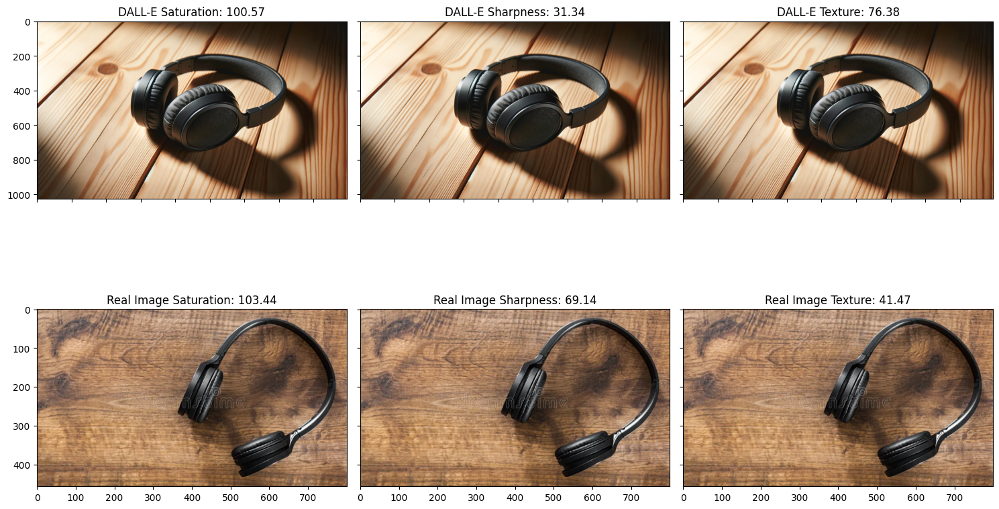

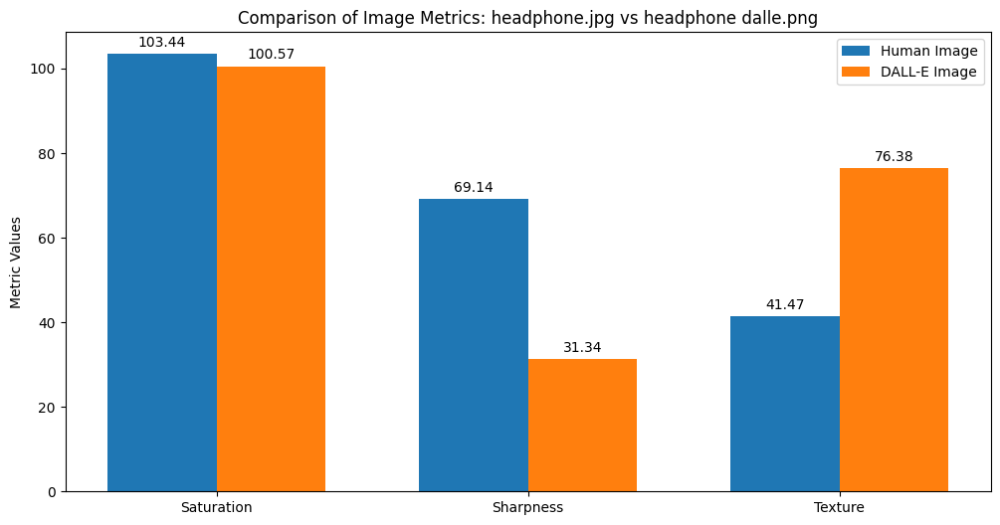

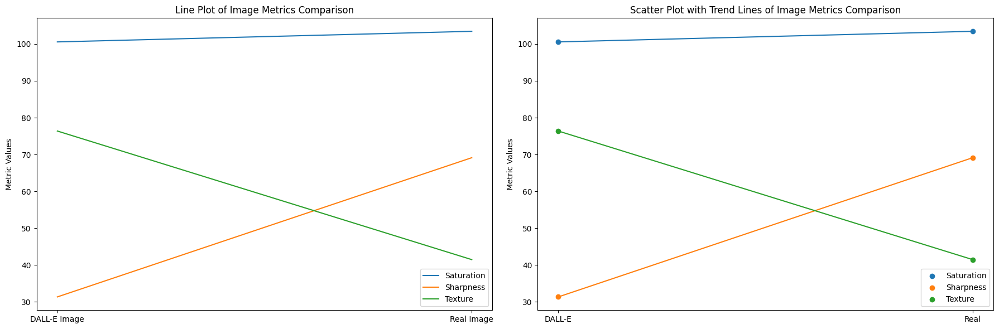


{'Saturation': {'t-statistic': -inf, 'p-value': 0.0}, 'Sharpness': {'t-statistic': -3.191267323717107e+16, 'p-value': 3.1216933679029986e-287}, 'Texture': {'t-statistic': 1.4738640163764004e+16, 'p-value': 3.415813039776416e-281}}


Metrics for laptop.jpg vs laptop dalle.png:
{'DALL-E Image': {'Saturation': 46.52384662628174, 'Sharpness': 35.063695624734194, 'Texture': 78.60264889752423}, 'Real Image': {'Saturation': 55.0781342993919, 'Sharpness': 84.40846103163895, 'Texture': 79.90087010228129}}


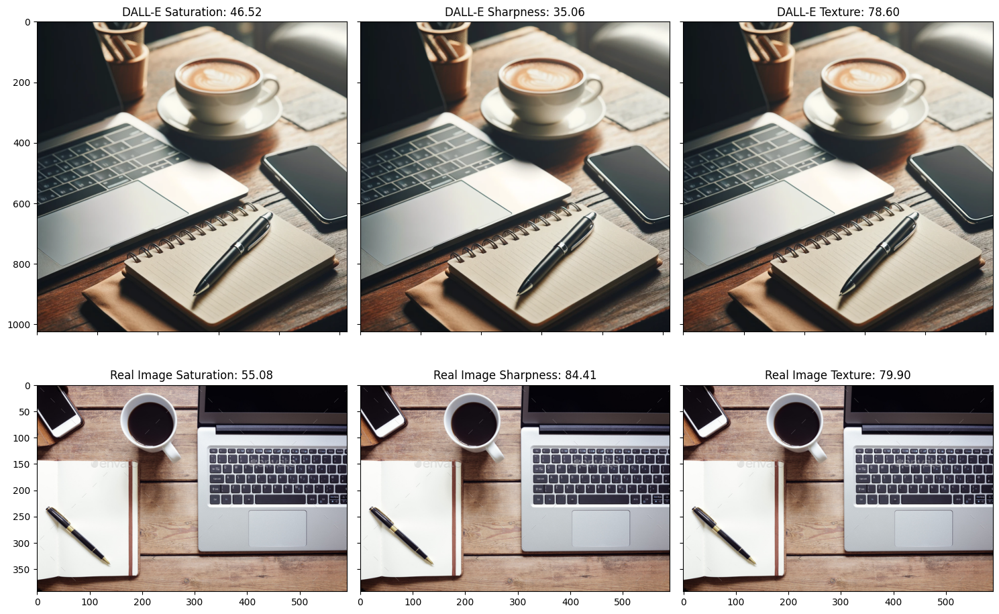

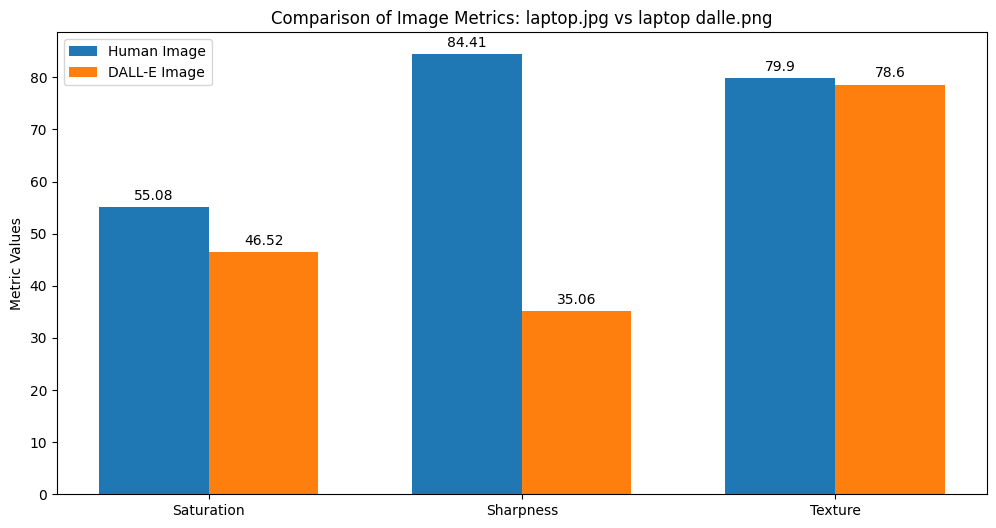

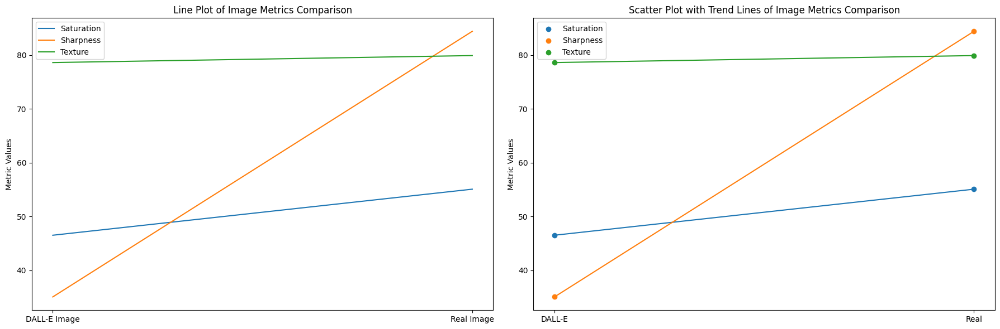


{'Saturation': {'t-statistic': -inf, 'p-value': 0.0}, 'Sharpness': {'t-statistic': -inf, 'p-value': 0.0}, 'Texture': {'t-statistic': -inf, 'p-value': 0.0}}


Metrics for picnic.jpg vs picnic dalle.png:
{'DALL-E Image': {'Saturation': 107.07913970947266, 'Sharpness': 56.91250181994471, 'Texture': 59.48146057024078}, 'Real Image': {'Saturation': 66.11580655526993, 'Sharpness': 52.8082260132929, 'Texture': 67.92507828427033}}


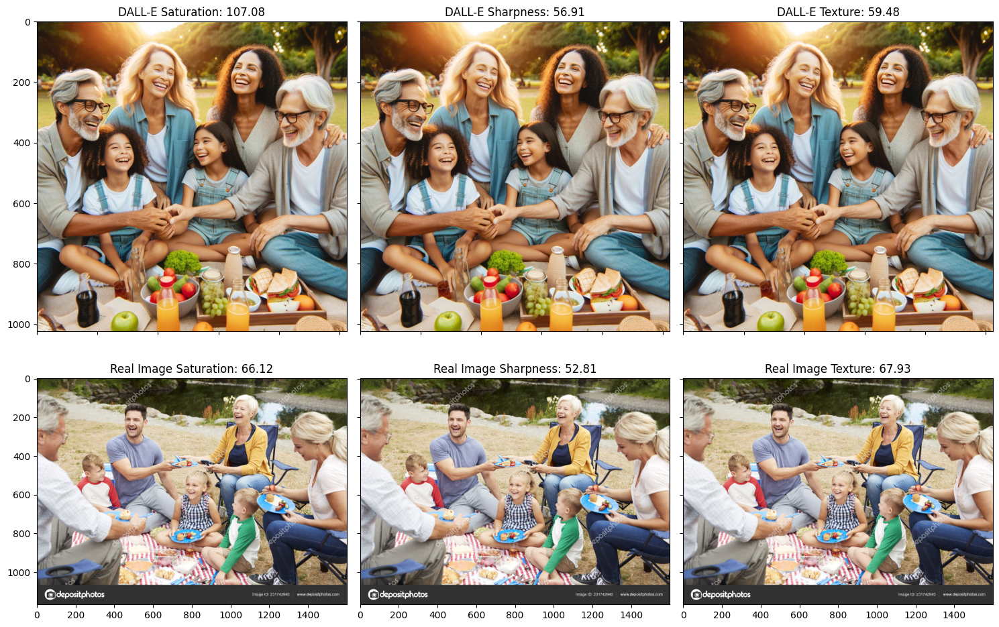

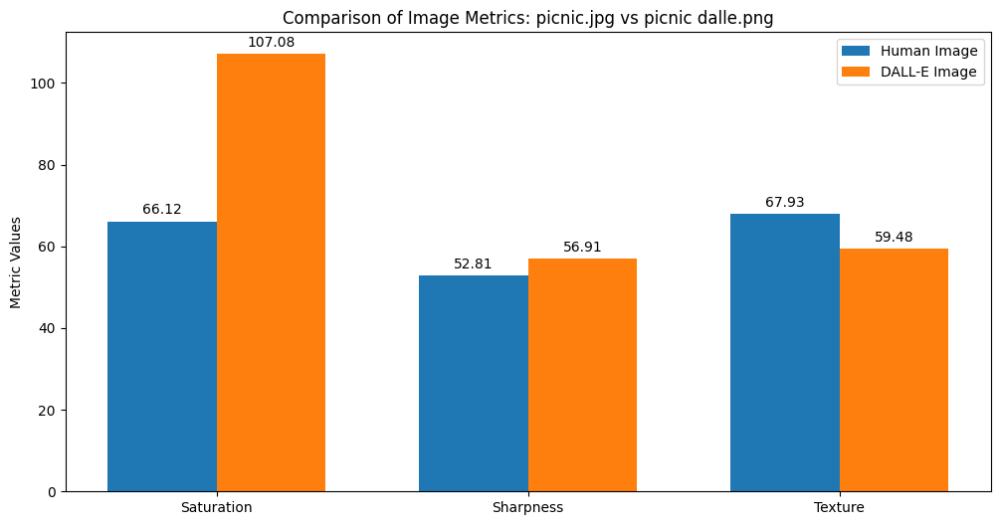

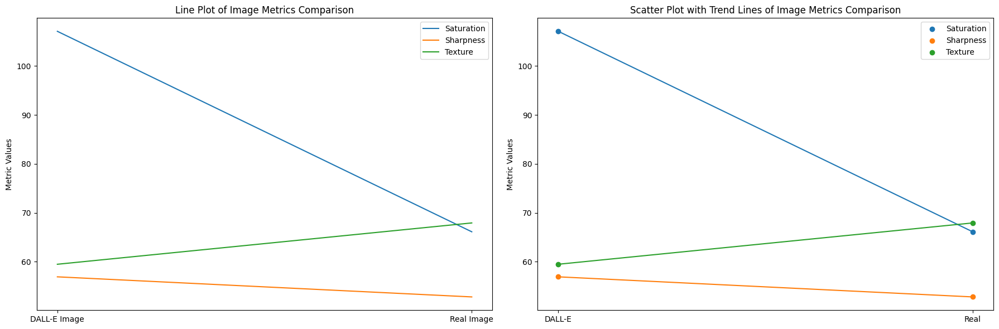


{'Saturation': {'t-statistic': inf, 'p-value': 0.0}, 'Sharpness': {'t-statistic': 1732876405637141.8, 'p-value': 1.853151753864655e-264}, 'Texture': {'t-statistic': -1782500324557609.2, 'p-value': 1.1147935869231518e-264}}


Metrics for snow.jpg vs snow dalle.png:
{'DALL-E Image': {'Saturation': 39.23026084899902, 'Sharpness': 69.33265867630992, 'Texture': 53.392256342690146}, 'Real Image': {'Saturation': 58.30302462182169, 'Sharpness': 103.93452932441821, 'Texture': 65.68017462348345}}


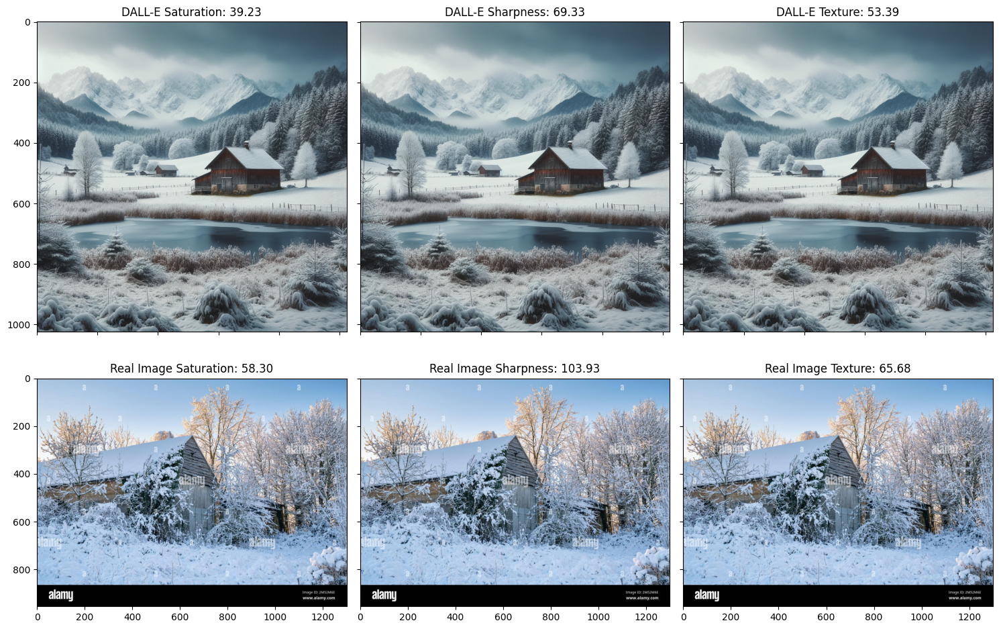

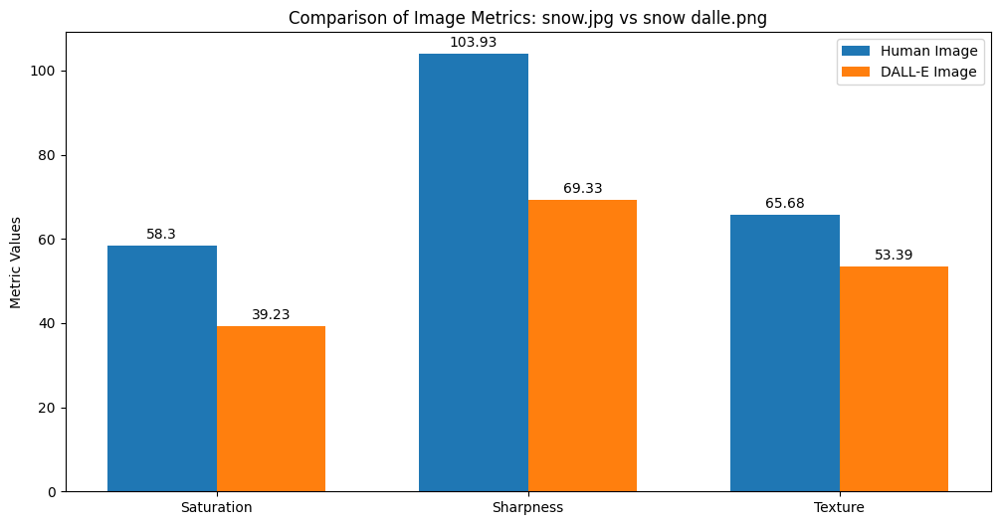

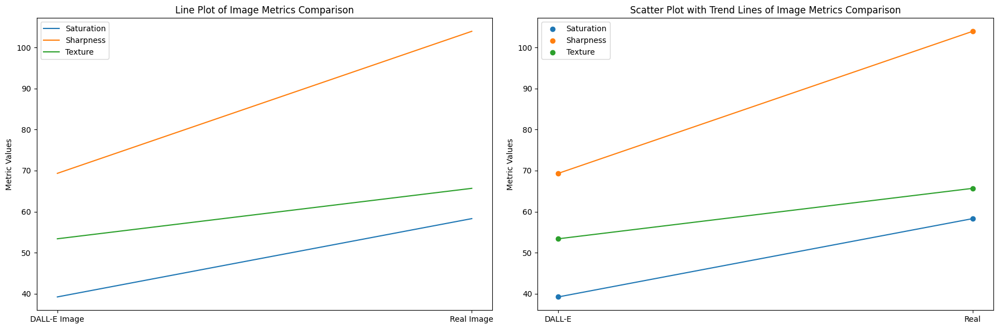


{'Saturation': {'t-statistic': -inf, 'p-value': 0.0}, 'Sharpness': {'t-statistic': -7304670551116055.0, 'p-value': 1.0493398710102076e-275}, 'Texture': {'t-statistic': -inf, 'p-value': 0.0}}


Metrics for sunflower.jpg vs sunflower dalle.png:
{'DALL-E Image': {'Saturation': 166.67985153198242, 'Sharpness': 65.08396036165308, 'Texture': 58.430881605363666}, 'Real Image': {'Saturation': 151.833225, 'Sharpness': 98.4712436267831, 'Texture': 58.99174108537525}}


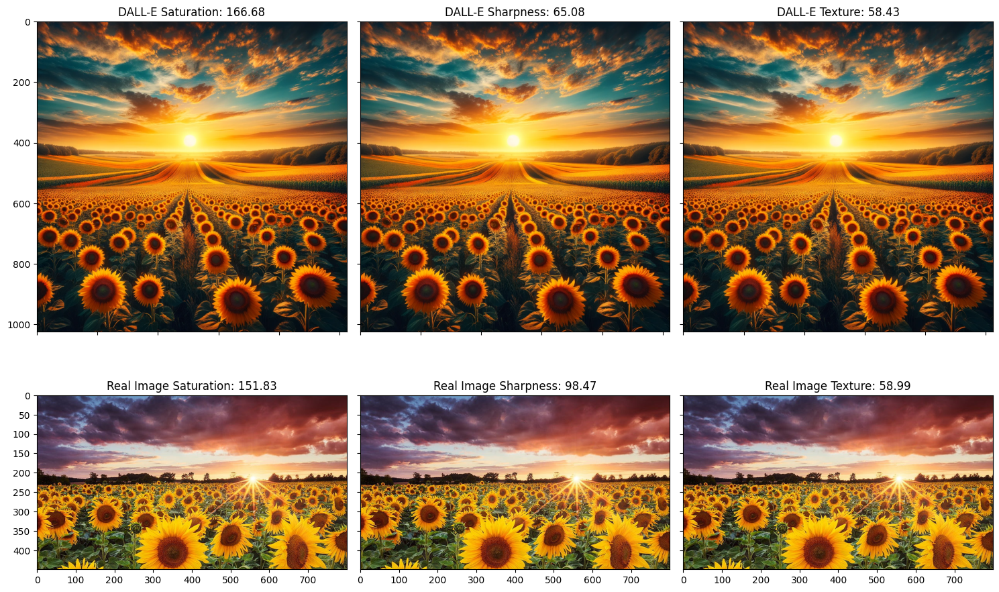

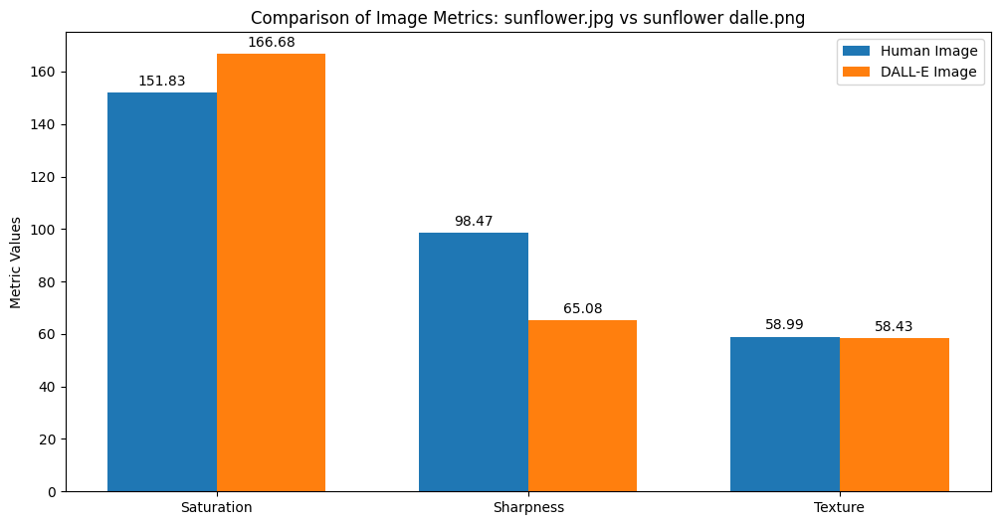

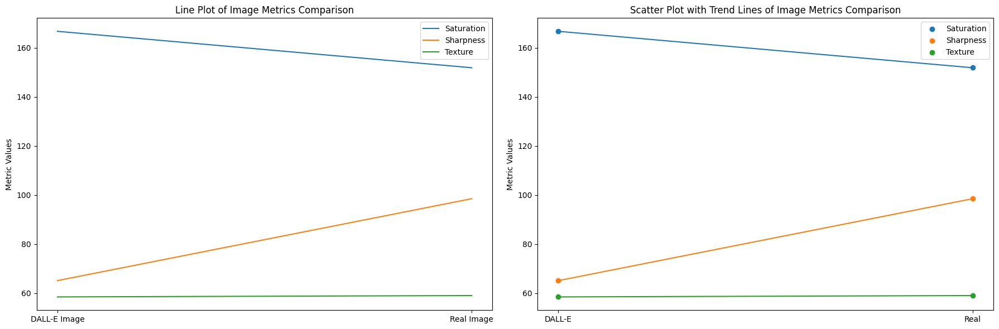


{'Saturation': {'t-statistic': 1567107696495581.8, 'p-value': 1.1322658124855318e-263}, 'Sharpness': {'t-statistic': -inf, 'p-value': 0.0}, 'Texture': {'t-statistic': -236801863611314.97, 'p-value': 6.711127531822552e-249}}


Metrics for traffic.jpg vs traffic dalle.png:
{'DALL-E Image': {'Saturation': 163.66004180908203, 'Sharpness': 40.37663888898168, 'Texture': 50.38297360455139}, 'Real Image': {'Saturation': 89.58866329073226, 'Sharpness': 35.43131256716665, 'Texture': 70.942892440985}}


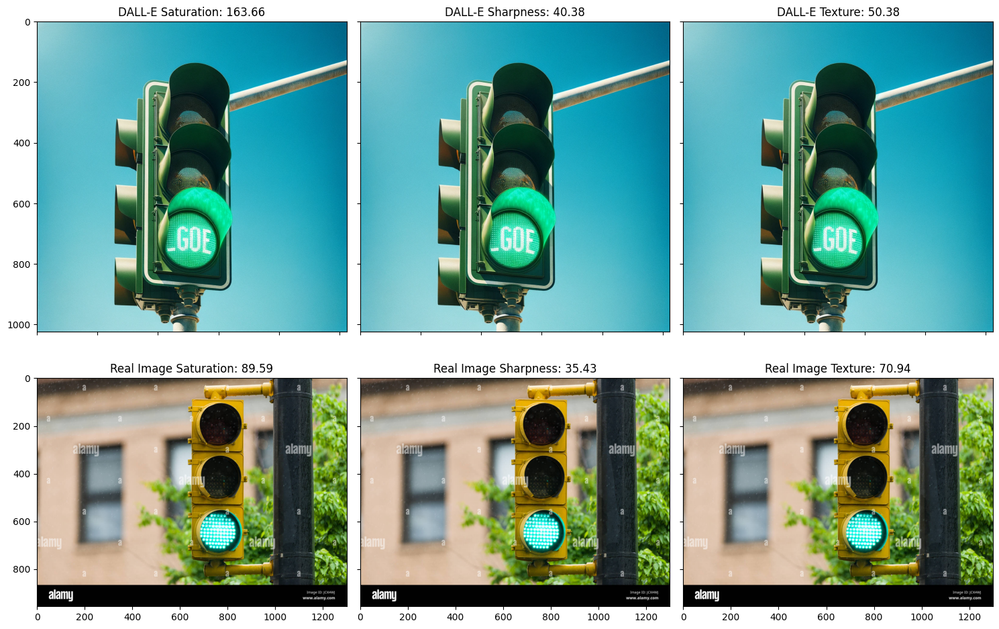

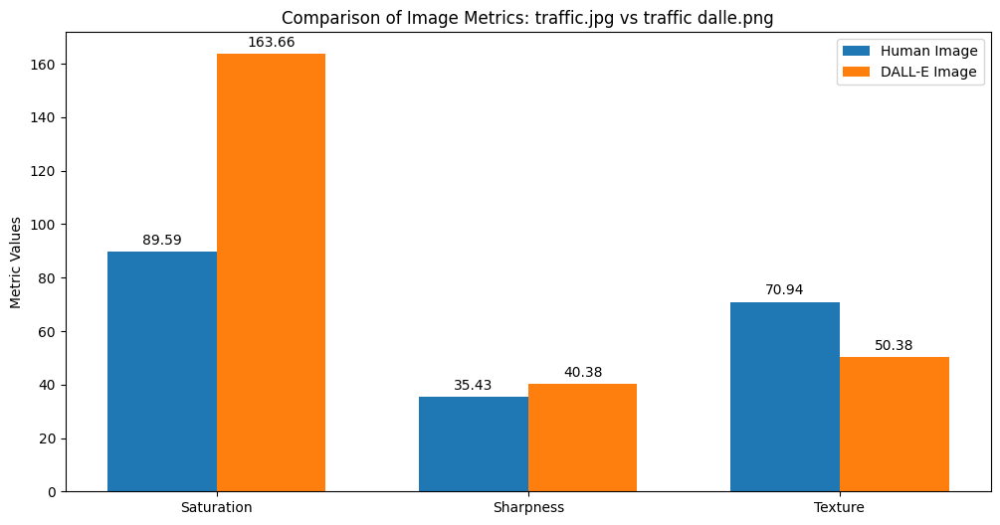

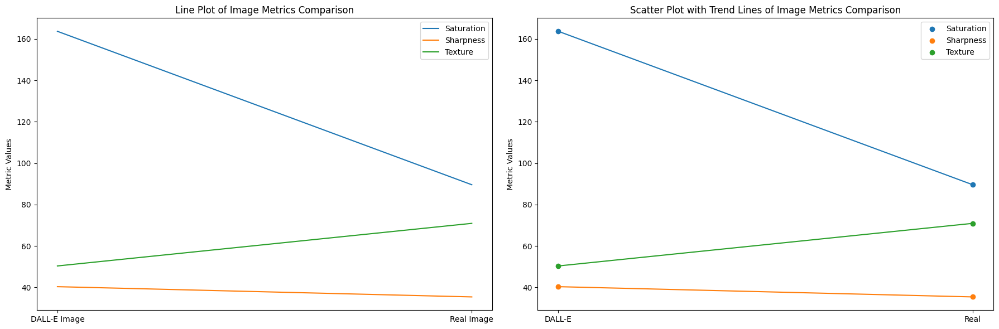


{'Saturation': {'t-statistic': inf, 'p-value': 0.0}, 'Sharpness': {'t-statistic': 2087978416889222.8, 'p-value': 6.466354149101451e-266}, 'Texture': {'t-statistic': -8680654013487191.0, 'p-value': 4.696599591216575e-277}}


Metrics for water.jpg vs water dalle.png:
{'DALL-E Image': {'Saturation': 54.59169673919678, 'Sharpness': 29.04362794647675, 'Texture': 69.07022483319003}, 'Real Image': {'Saturation': 78.3919926630783, 'Sharpness': 35.25763650047273, 'Texture': 43.445889204419885}}


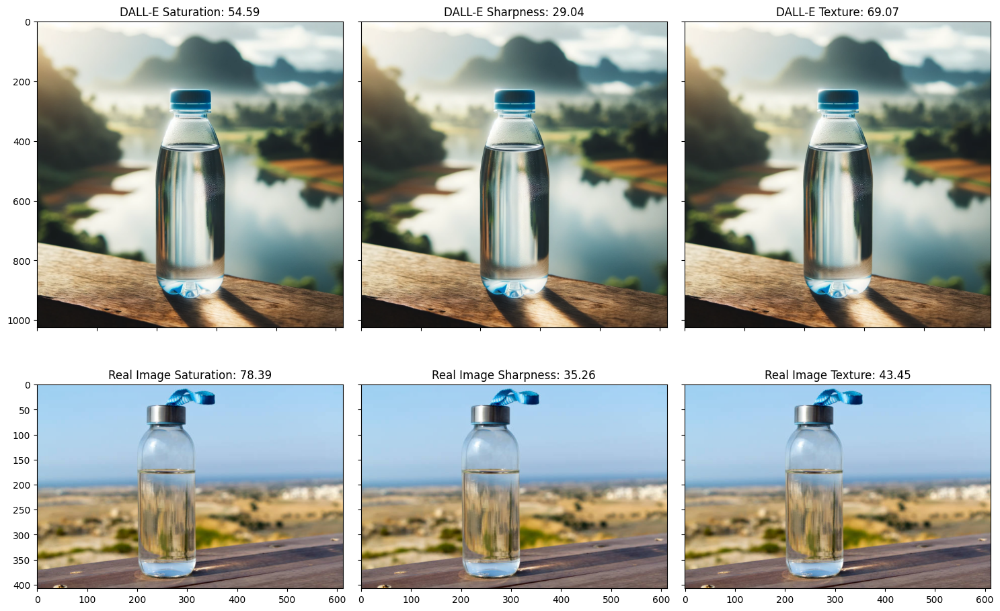

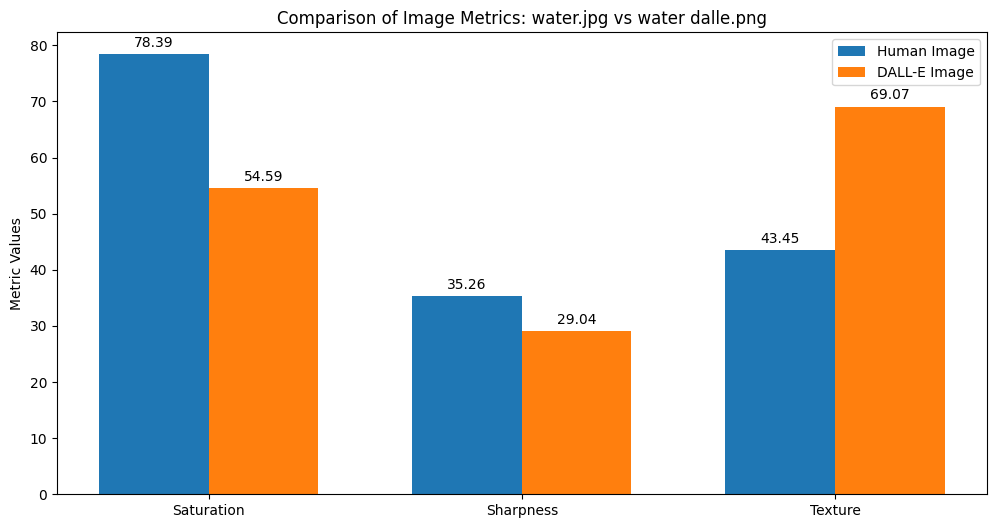

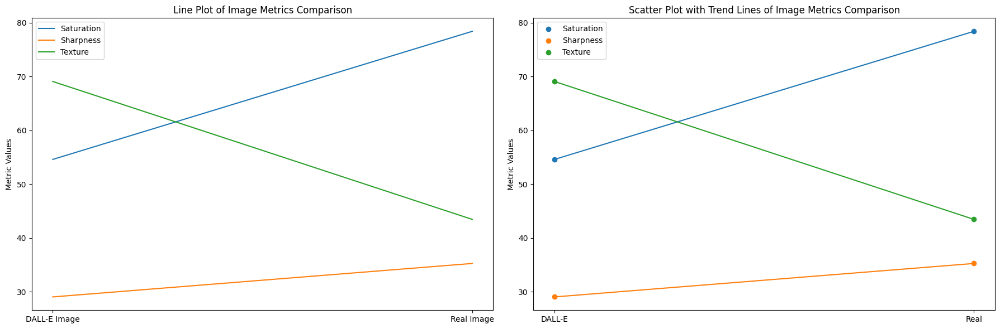


{'Saturation': {'t-statistic': -inf, 'p-value': 0.0}, 'Sharpness': {'t-statistic': -2623631869523749.0, 'p-value': 1.060413920391568e-267}, 'Texture': {'t-statistic': 5409456955750577.0, 'p-value': 2.3386300720645356e-273}}


Metrics for white.jpg vs white dalle.png:
{'DALL-E Image': {'Saturation': 76.95926475524902, 'Sharpness': 45.56378029029049, 'Texture': 67.58616635535282}, 'Real Image': {'Saturation': 43.12769957131271, 'Sharpness': 36.649617166709554, 'Texture': 59.96178095087183}}


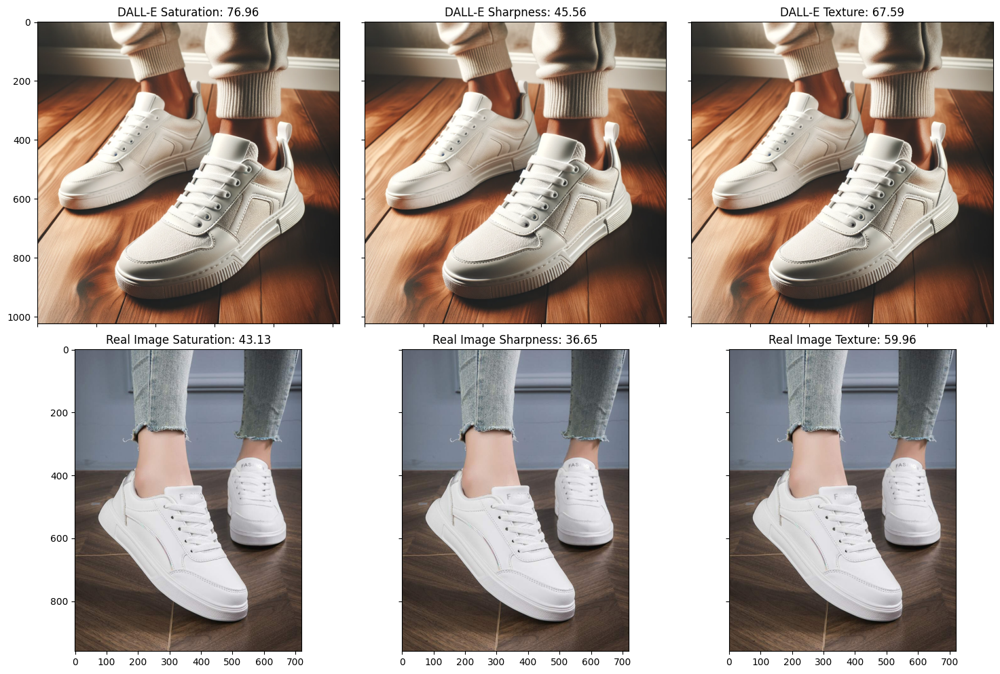

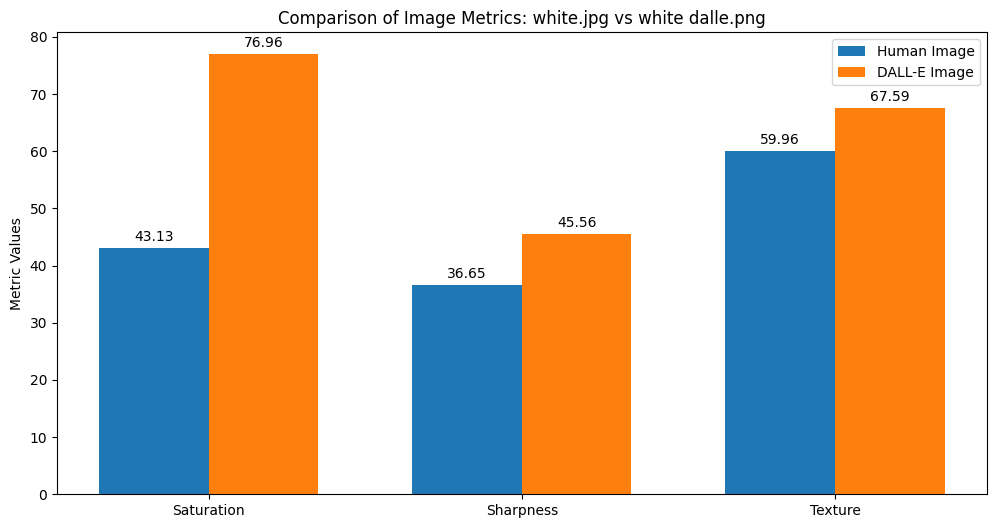

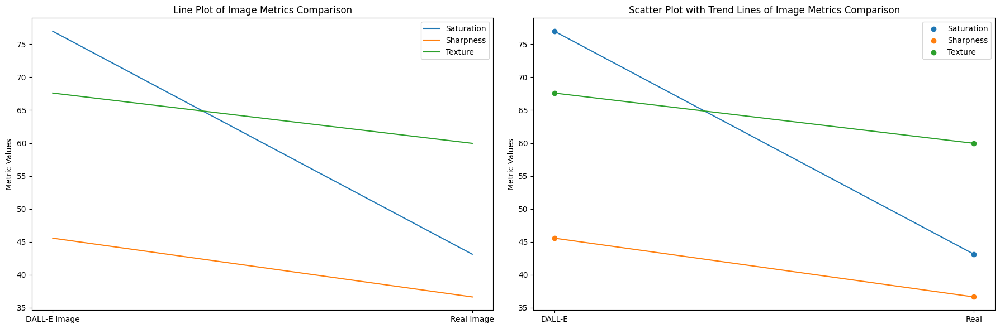


{'Saturation': {'t-statistic': 1.4284108533350272e+16, 'p-value': 6.003037185264634e-281}, 'Sharpness': {'t-statistic': inf, 'p-value': 0.0}, 'Texture': {'t-statistic': 3219110556239030.5, 'p-value': 2.6698171489964273e-269}}




In [6]:



# Read images from folders
human_images = sorted(os.listdir(human_folder_path))
dalle_images = sorted(os.listdir(dalle_folder_path))

# Function to extract the base name (without dalle part and extension)
def extract_base_name(filename):
    return filename.split('_dalle')[0].split('.')[0]

# Pairing images based on base name
paired_images = []
for hi in human_images:
    base_name = extract_base_name(hi)
    for di in dalle_images:
        if base_name in di:
            paired_images.append((hi, di))
            break

# Iterate over each pair and perform analysis
for human_image, dalle_image in paired_images:
    human_img_path = os.path.join(human_folder_path, human_image)
    dalle_img_path = os.path.join(dalle_folder_path, dalle_image)

    # Open images
    human_img = Image.open(human_img_path)
    dalle_img = Image.open(dalle_img_path)

    # Calculate metrics for both images
    human_saturation = calculate_saturation(human_img)
    dalle_saturation = calculate_saturation(dalle_img)
    human_sharpness = calculate_edge_sharpness(human_img)
    dalle_sharpness = calculate_edge_sharpness(dalle_img)
    human_texture = calculate_texture_details(human_img)
    dalle_texture = calculate_texture_details(dalle_img)

    # Results
    metrics = {
        "DALL-E Image": {
            "Saturation": dalle_saturation,
            "Sharpness": dalle_sharpness,
            "Texture": dalle_texture
        },
        "Real Image": {
            "Saturation": human_saturation,
            "Sharpness": human_sharpness,
            "Texture": human_texture
        }
    }

    # Print metrics
    print(f"Metrics for {human_image} vs {dalle_image}:")
    print(metrics)

    # Visualize the metrics
    fig, axs = plt.subplots(2, 3, figsize=(15, 10))

    # Saturation
    axs[0, 0].imshow(dalle_img)
    axs[0, 0].set_title(f"DALL-E Saturation: {dalle_saturation:.2f}")
    axs[1, 0].imshow(human_img)
    axs[1, 0].set_title(f"Real Image Saturation: {human_saturation:.2f}")

    # Sharpness
    axs[0, 1].imshow(dalle_img, cmap='gray')
    axs[0, 1].set_title(f"DALL-E Sharpness: {dalle_sharpness:.2f}")
    axs[1, 1].imshow(human_img, cmap='gray')
    axs[1, 1].set_title(f"Real Image Sharpness: {human_sharpness:.2f}")

    # Texture
    axs[0, 2].imshow(dalle_img, cmap='gray')
    axs[0, 2].set_title(f"DALL-E Texture: {dalle_texture:.2f}")
    axs[1, 2].imshow(human_img, cmap='gray')
    axs[1, 2].set_title(f"Real Image Texture: {human_texture:.2f}")

    # Remove axis labels for clarity
    for ax in axs.flat:
        ax.label_outer()

    plt.tight_layout()
    plt.show()

        # Display results and comparisons for each pair
    metrics_categories = ['Saturation', 'Sharpness', 'Texture']
    human_values = [human_saturation, human_sharpness, human_texture]
    dalle_values = [dalle_saturation, dalle_sharpness, dalle_texture]

    x = np.arange(len(metrics_categories))  # the label locations
    width = 0.35  # the width of the bars

    fig, ax = plt.subplots(figsize=(12, 6))
    rects1 = ax.bar(x - width/2, human_values, width, label='Human Image')
    rects2 = ax.bar(x + width/2, dalle_values, width, label='DALL-E Image')

    ax.set_ylabel('Metric Values')
    ax.set_title(f'Comparison of Image Metrics: {human_image} vs {dalle_image}')
    ax.set_xticks(x)
    ax.set_xticklabels(metrics_categories)
    ax.legend()

    def autolabel(rects):
        for rect in rects:
            height = rect.get_height()
            ax.annotate('{}'.format(round(height, 2)),
                        xy=(rect.get_x() + rect.get_width() / 2, height),
                        xytext=(0, 3),
                        textcoords="offset points",
                        ha='center', va='bottom')

    autolabel(rects1)
    autolabel(rects2)
    plt.show()

    fig, axs = plt.subplots(1, 2, figsize=(18, 6))

    # Line plot
    for i, metric in enumerate(metrics_categories):
        axs[0].plot([1, 2], [dalle_values[i], human_values[i]], label=f'{metric}')

    # Scatter plot with trend lines
    for i, metric in enumerate(metrics_categories):
        axs[1].scatter(['DALL-E', 'Real'], [dalle_values[i], human_values[i]], label=f'{metric}')
        axs[1].plot(['DALL-E', 'Real'], [dalle_values[i], human_values[i]])

    # Customize line plot
    axs[0].set_xticks([1, 2])
    axs[0].set_xticklabels(['DALL-E Image', 'Real Image'])
    axs[0].set_ylabel('Metric Values')
    axs[0].set_title('Line Plot of Image Metrics Comparison')
    axs[0].legend()

    # Customize scatter plot
    axs[1].set_xticks(['DALL-E', 'Real'])
    axs[1].set_ylabel('Metric Values')
    axs[1].set_title('Scatter Plot with Trend Lines of Image Metrics Comparison')
    axs[1].legend()

    plt.tight_layout()
    plt.show()
    # We create an artificial sample of 10 values for each measurement since we only have one measurement per image.
    dalle_sample = np.array([dalle_values] * 10)
    real_sample = np.array([human_values] * 10)

    # Perform t-tests
    t_test_results = {}
    for i, metric in enumerate(metrics_categories):
        t_stat, p_val = stats.ttest_ind(dalle_sample[:, i], real_sample[:, i])
        t_test_results[metric] = {'t-statistic': t_stat, 'p-value': p_val}

    print()
    print(t_test_results)

    print()
    print()




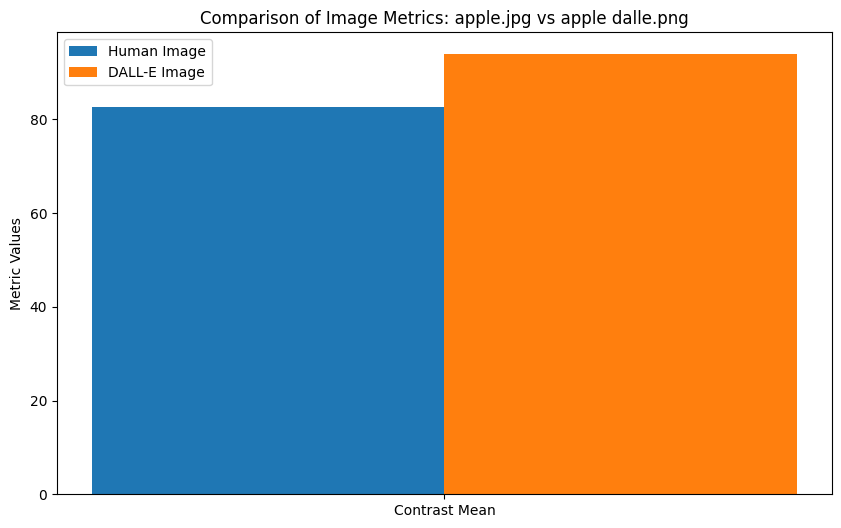

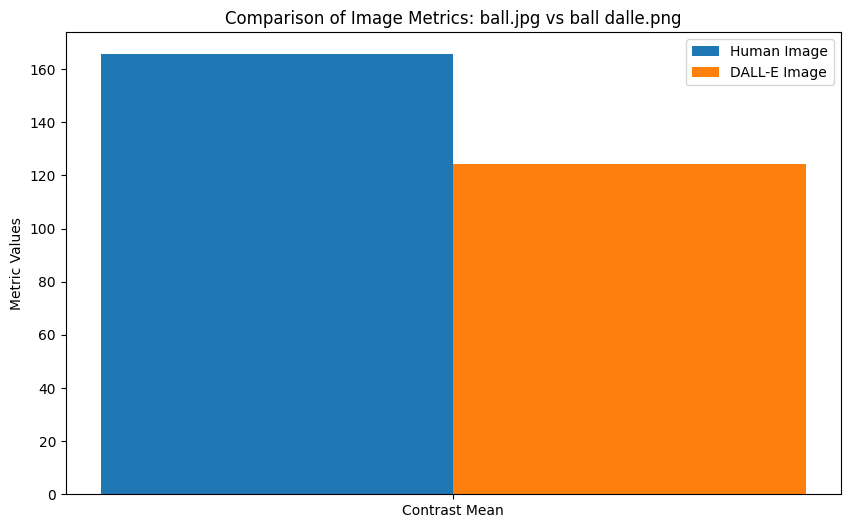

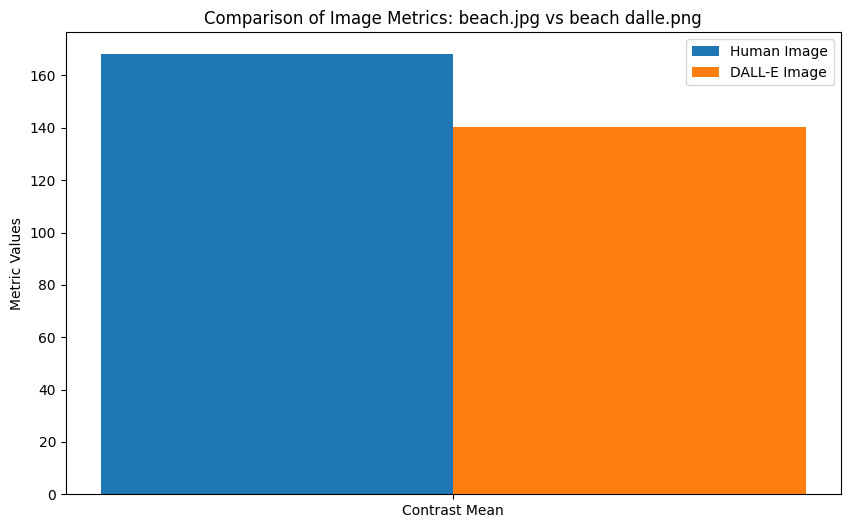

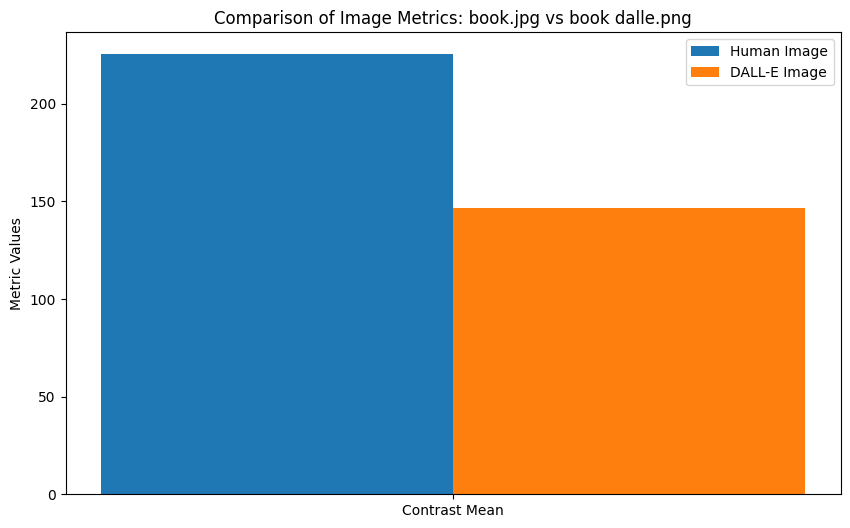

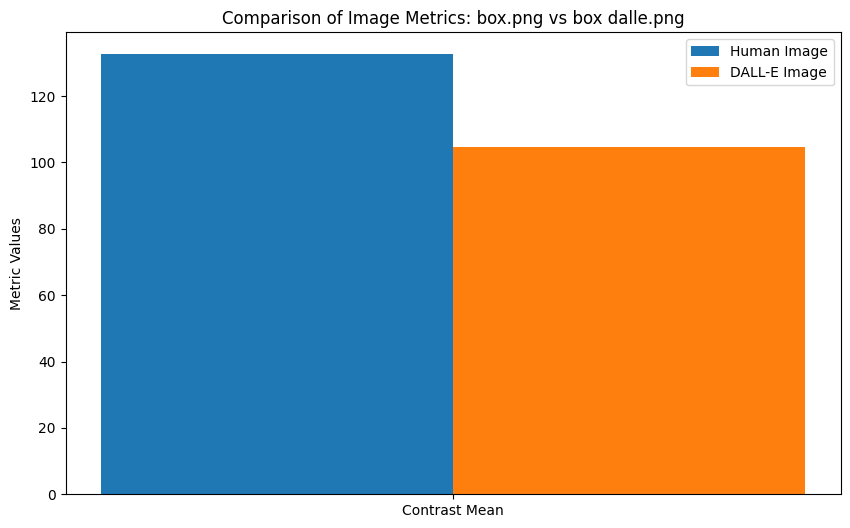

...

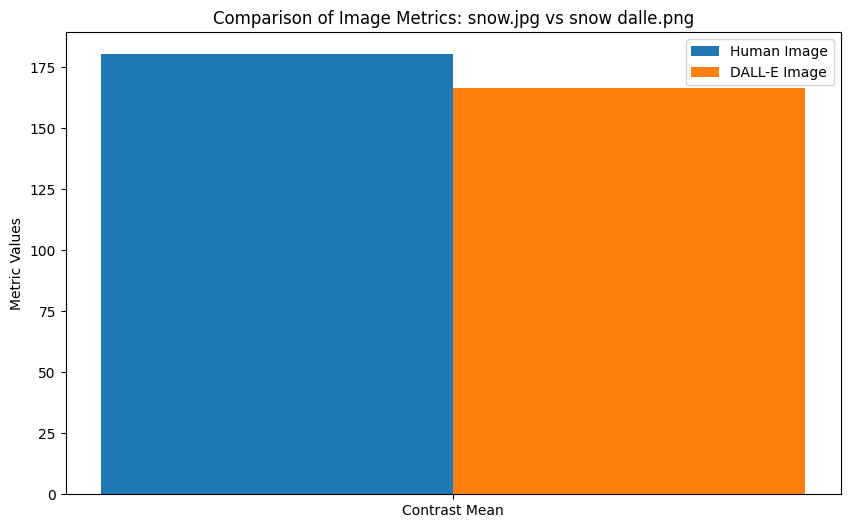

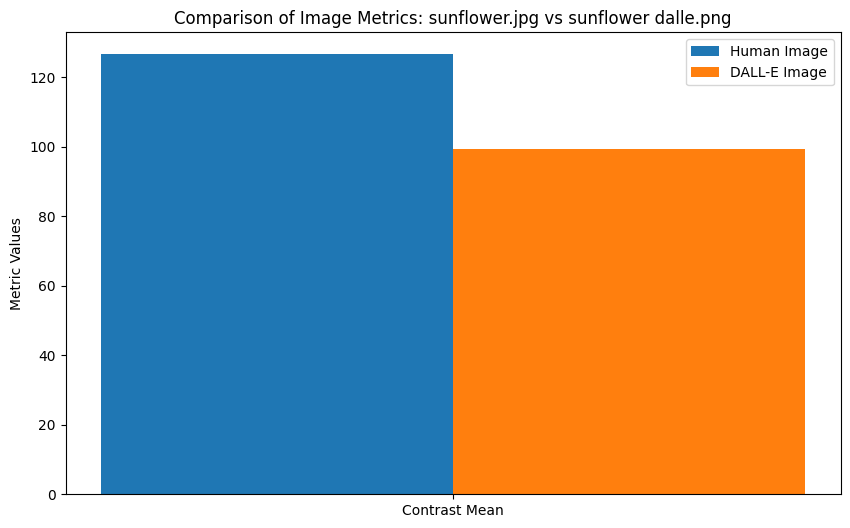

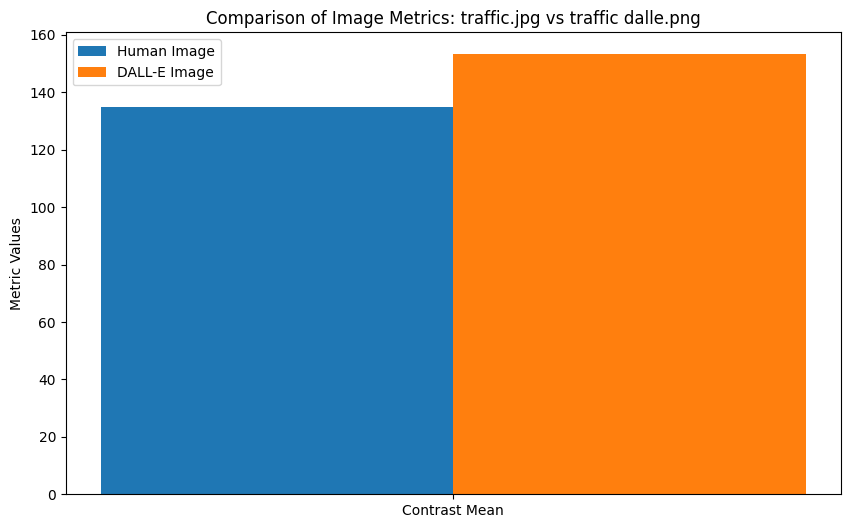

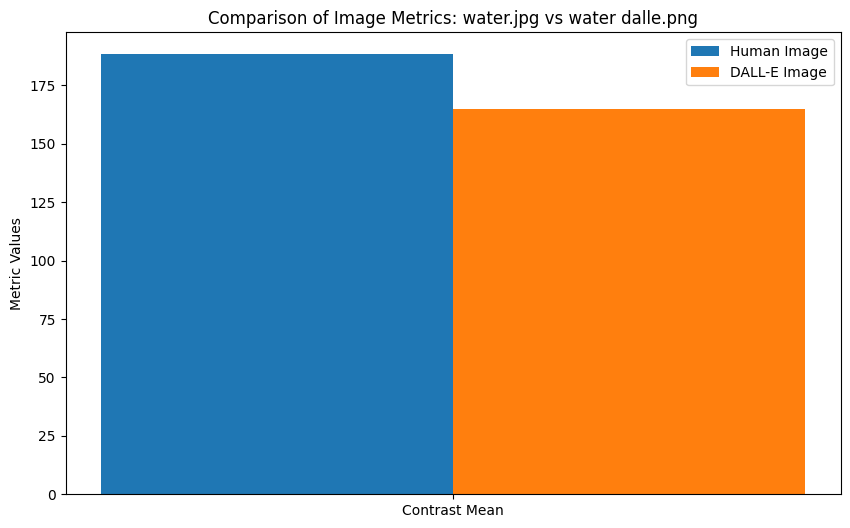

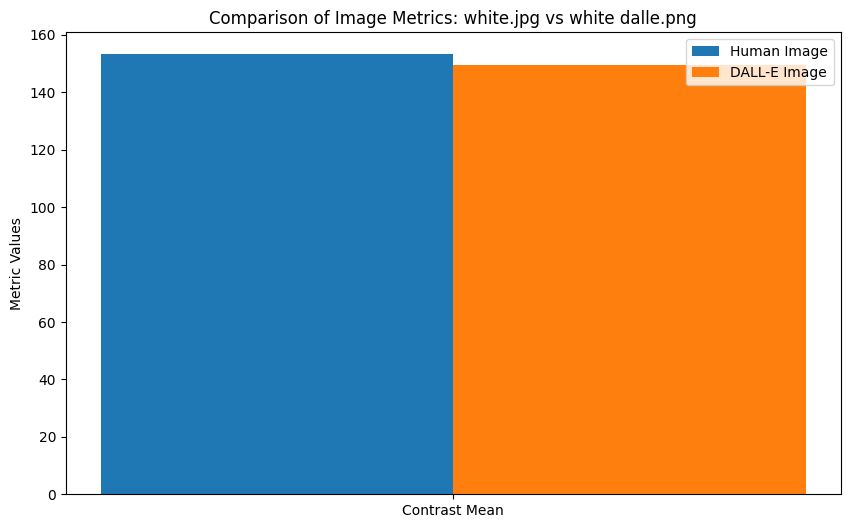

In [8]:
import os
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
from scipy.fftpack import fftn, ifftn, fftshift

def adjust_contrast(image_path, alpha=1.2):
    image = cv2.imread(image_path)
    adjusted = cv2.convertScaleAbs(image, alpha=alpha)
    return adjusted

def apply_frequency_domain_filtering(image_path):
    image = cv2.imread(image_path, 0)
    f = fftn(image)
    fshift = fftshift(f)
    magnitude_spectrum = 20 * np.log(np.abs(fshift))
    return magnitude_spectrum

def apply_gaussian_blur(image_path, kernel_size=(5, 5)):
    image = cv2.imread(image_path)
    blurred = cv2.GaussianBlur(image, kernel_size, 0)
    return blurred

def apply_edge_detection(image_path, threshold1=100, threshold2=200):
    image = cv2.imread(image_path, 0)
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

def apply_histogram_equalization(image_path):
    image = cv2.imread(image_path, 0)
    equalized = cv2.equalizeHist(image)
    return equalized

def apply_median_filtering(image_path, kernel_size=5):
    image = cv2.imread(image_path)
    median = cv2.medianBlur(image, kernel_size)
    return median

paired_images = pair_images(human_folder_path, dalle_folder_path)

# Iterate over each pair and perform analysis
for human_img_path, dalle_img_path in paired_images:
    # Apply image processing techniques
    human_contrast = adjust_contrast(human_img_path)
    dalle_contrast = adjust_contrast(dalle_img_path)

    # Example of calculating a simple metric (e.g., mean pixel value) for contrast-adjusted images
    human_contrast_metric = np.mean(human_contrast)
    dalle_contrast_metric = np.mean(dalle_contrast)

    # Prepare and plot metrics (expand this as per your analysis requirements)
    metrics = {
        'Human Image': {'Contrast Mean': human_contrast_metric},
        'DALL-E Image': {'Contrast Mean': dalle_contrast_metric}
    }

    human_img_name = os.path.basename(human_img_path)
    dalle_img_name = os.path.basename(dalle_img_path)
    plot_metrics_comparison(metrics, human_img_name, dalle_img_name)


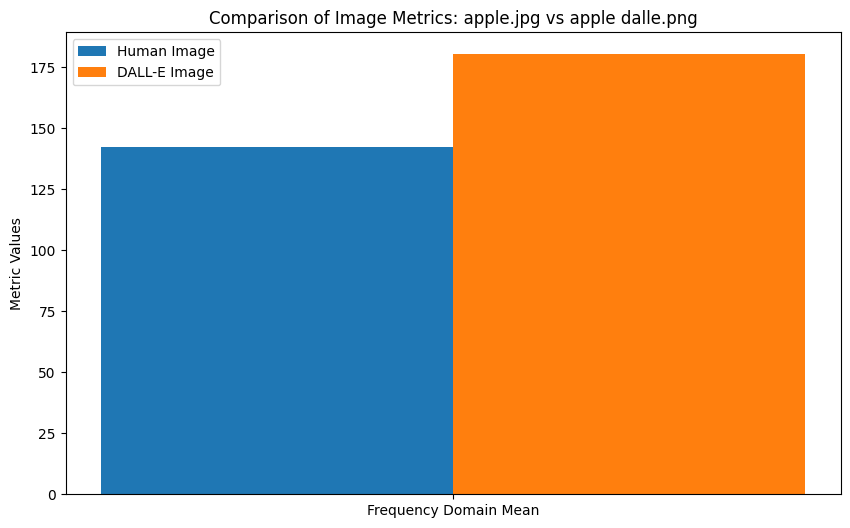

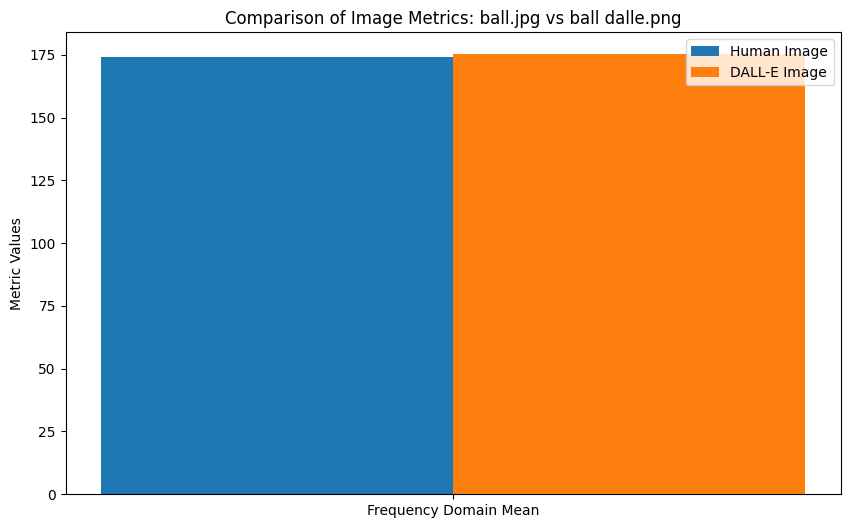

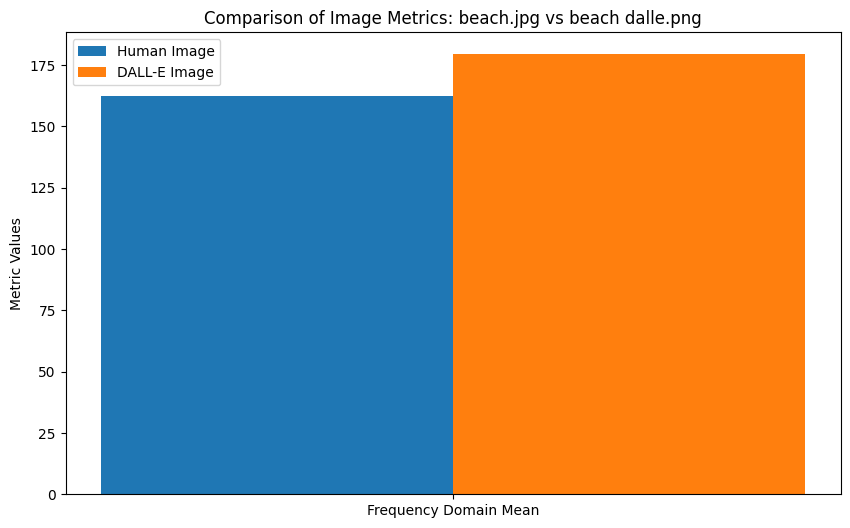

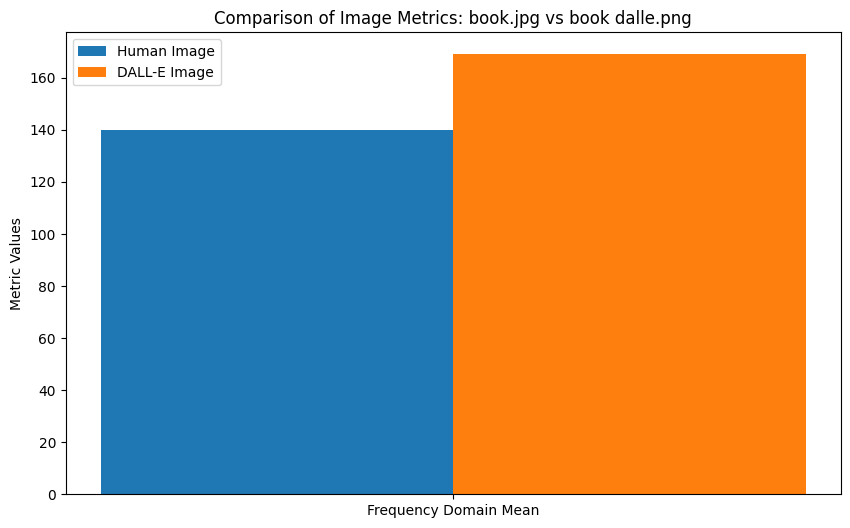

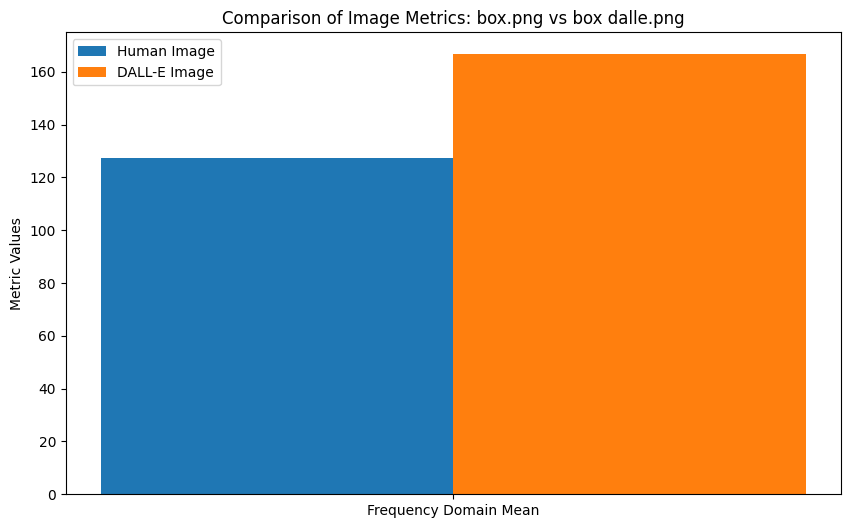

...

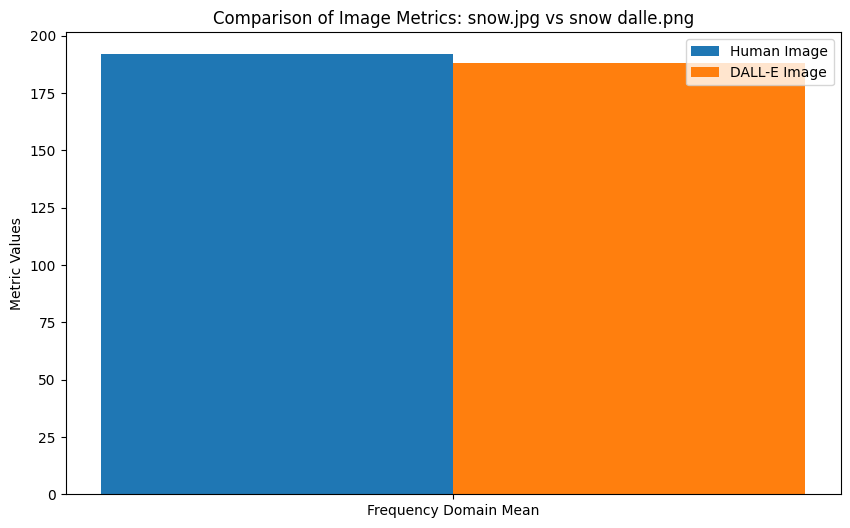

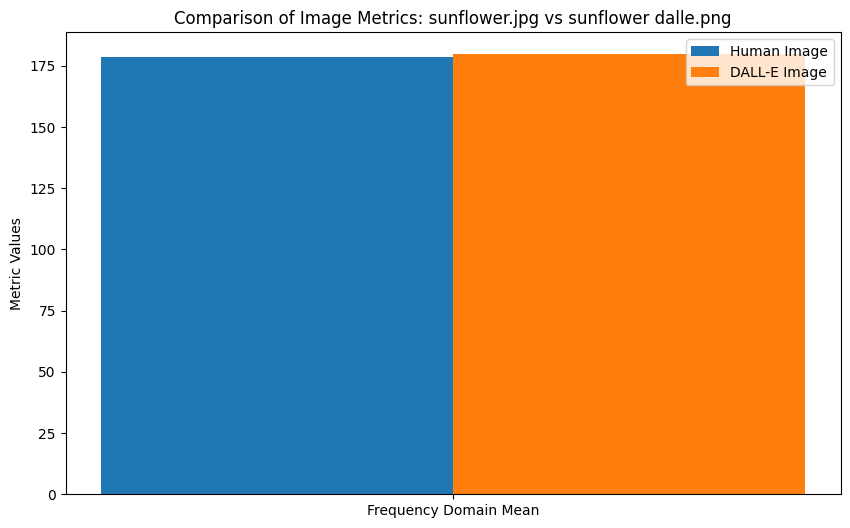

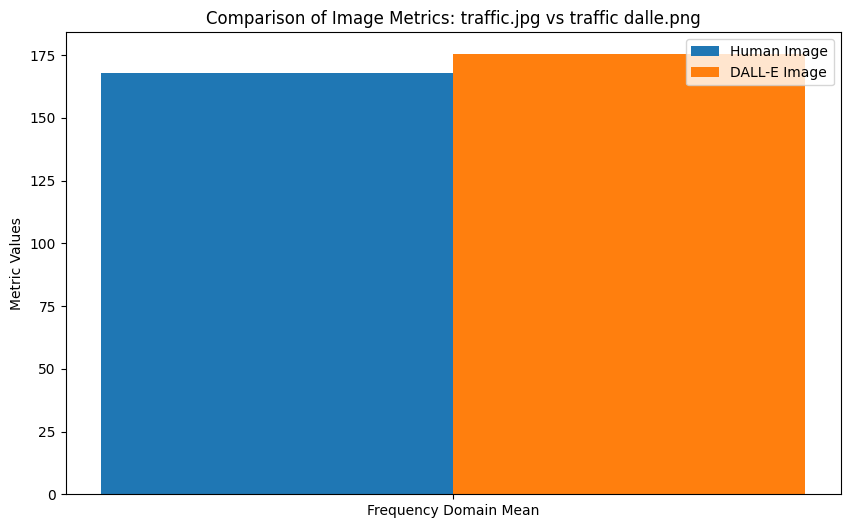

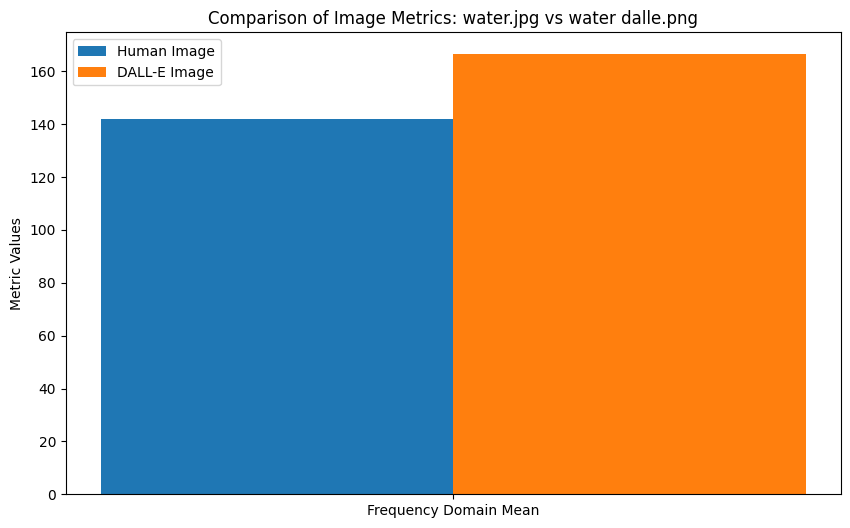

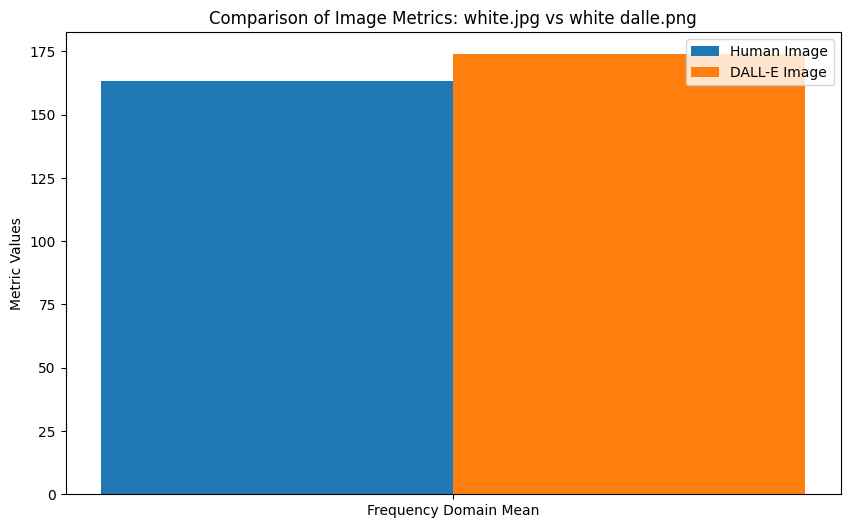

In [12]:


# Iterate over each pair and perform analysis
for human_img_path, dalle_img_path in paired_images:

    # Apply Frequency Domain Filtering
    human_frequency = apply_frequency_domain_filtering(human_img_path)
    dalle_frequency = apply_frequency_domain_filtering(dalle_img_path)
    human_frequency_metric = np.mean(human_frequency)
    dalle_frequency_metric = np.mean(dalle_frequency)


    # Collect all metrics
    metrics = {
        'Human Image': {
            'Frequency Domain Mean': human_frequency_metric,
        },
        'DALL-E Image': {
            'Frequency Domain Mean': dalle_frequency_metric,
        }
    }


    # Plot metrics comparison
    human_img_name = os.path.basename(human_img_path)
    dalle_img_name = os.path.basename(dalle_img_path)
    plot_metrics_comparison(metrics, human_img_name, dalle_img_name)


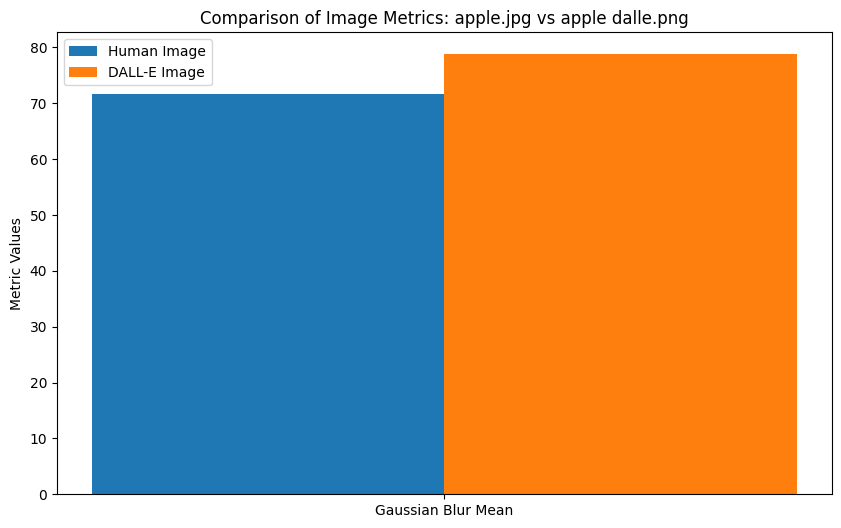

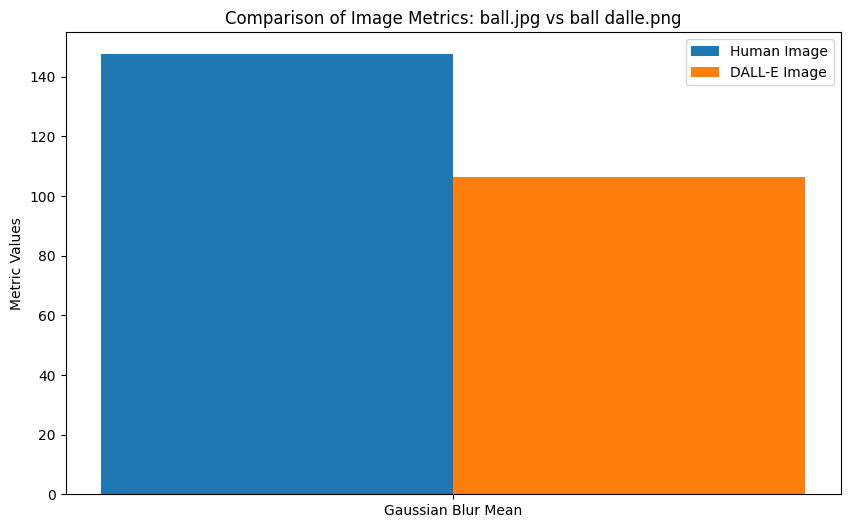

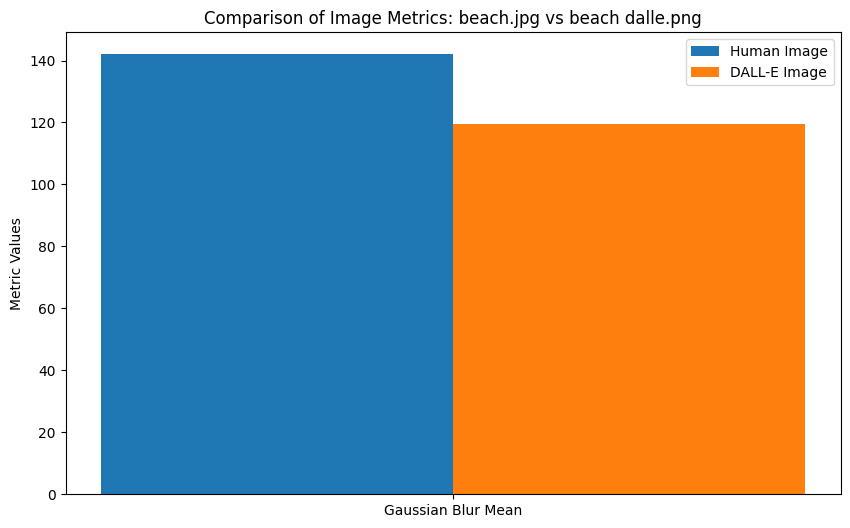

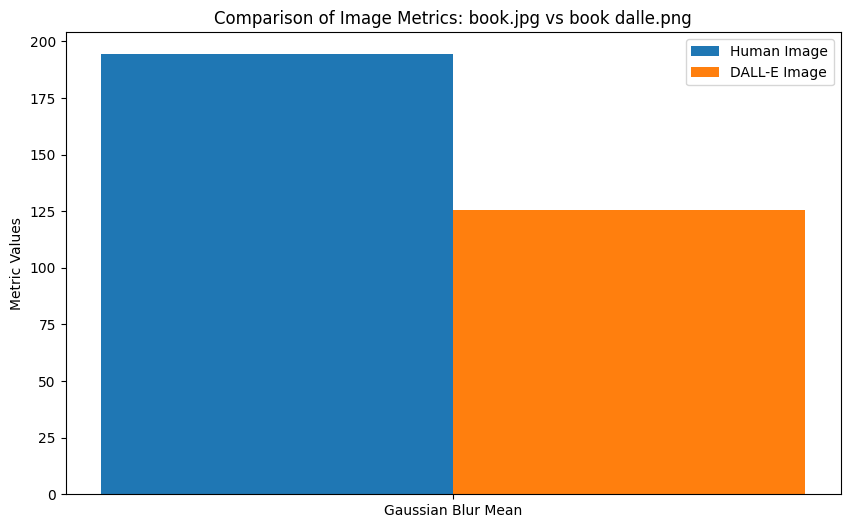

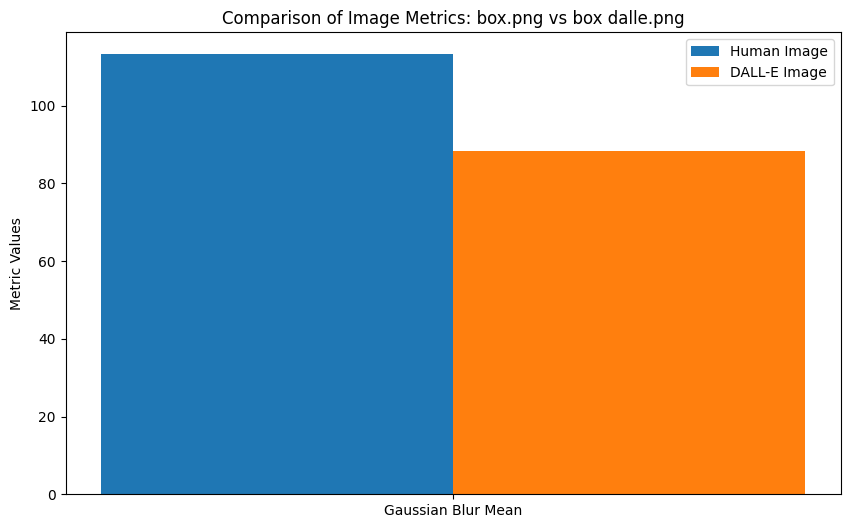

...

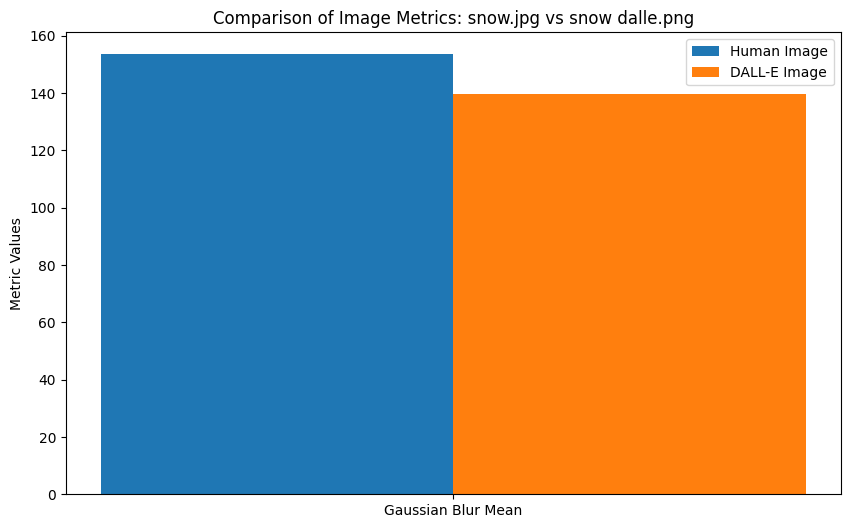

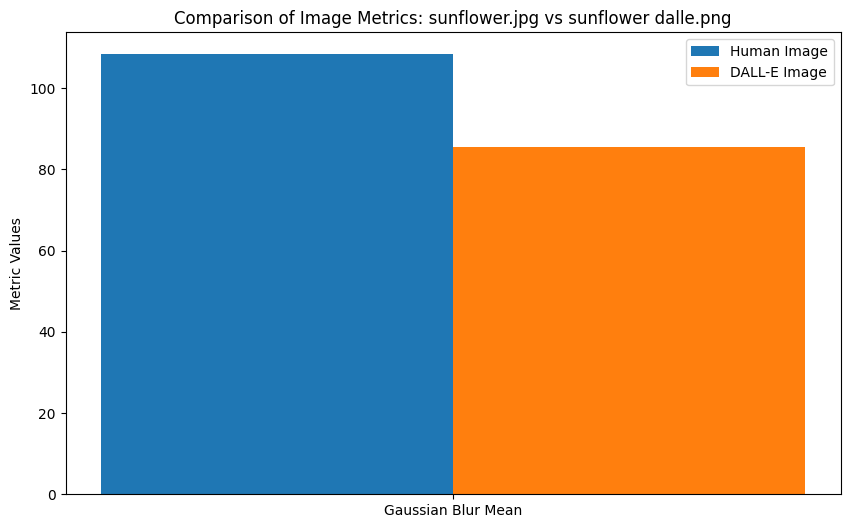

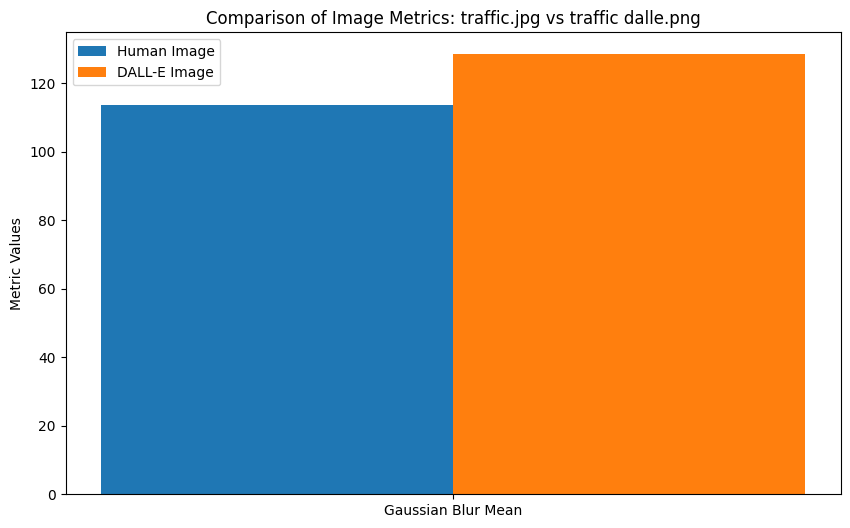

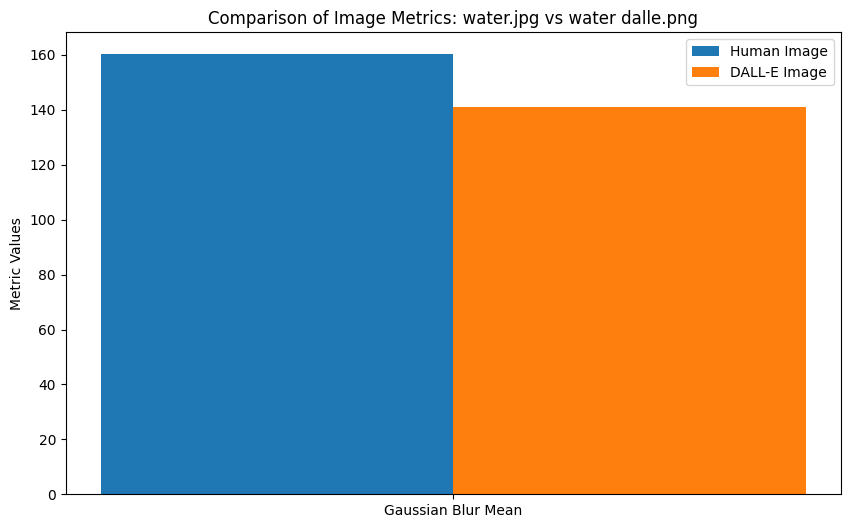

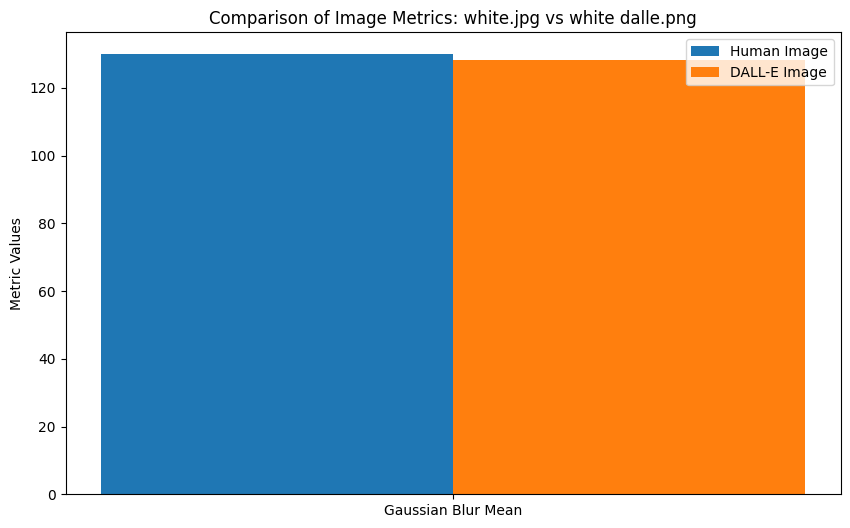

In [16]:

# Iterate over each pair and perform analysis
for human_img_path, dalle_img_path in paired_images:

    # Apply Gaussian Blur
    human_blur = apply_gaussian_blur(human_img_path)
    dalle_blur = apply_gaussian_blur(dalle_img_path)
    human_blur_metric = np.mean(human_blur)
    dalle_blur_metric = np.mean(dalle_blur)



    # Collect all metrics
    metrics = {
        'Human Image': {

            'Gaussian Blur Mean': human_blur_metric,

        },
        'DALL-E Image': {

           'Gaussian Blur Mean': dalle_blur_metric,

        }
    }


    # Plot metrics comparison
    human_img_name = os.path.basename(human_img_path)
    dalle_img_name = os.path.basename(dalle_img_path)
    plot_metrics_comparison(metrics, human_img_name, dalle_img_name)


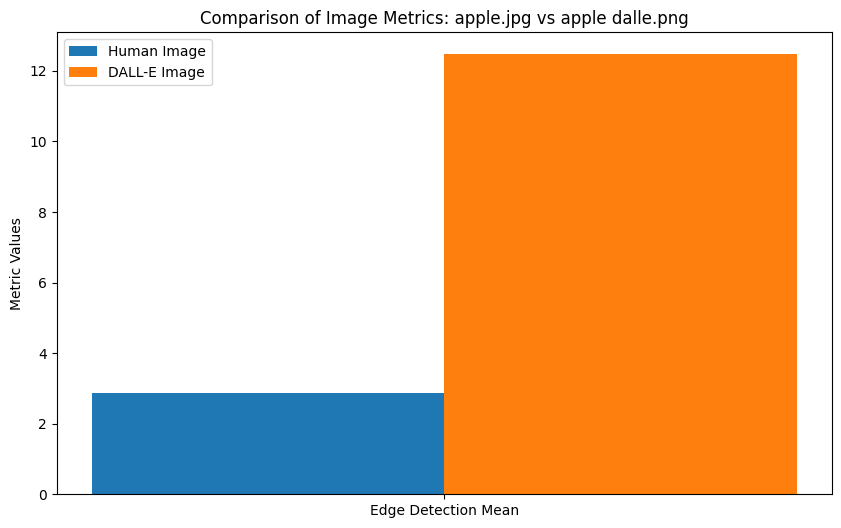

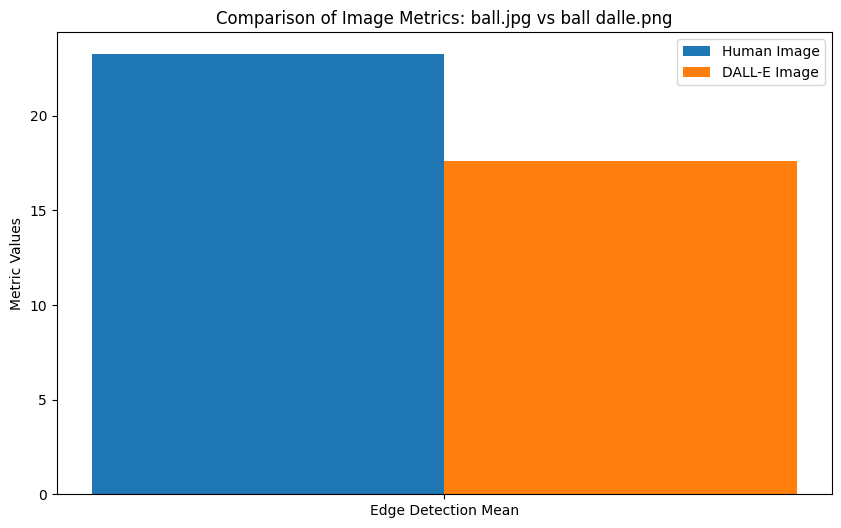

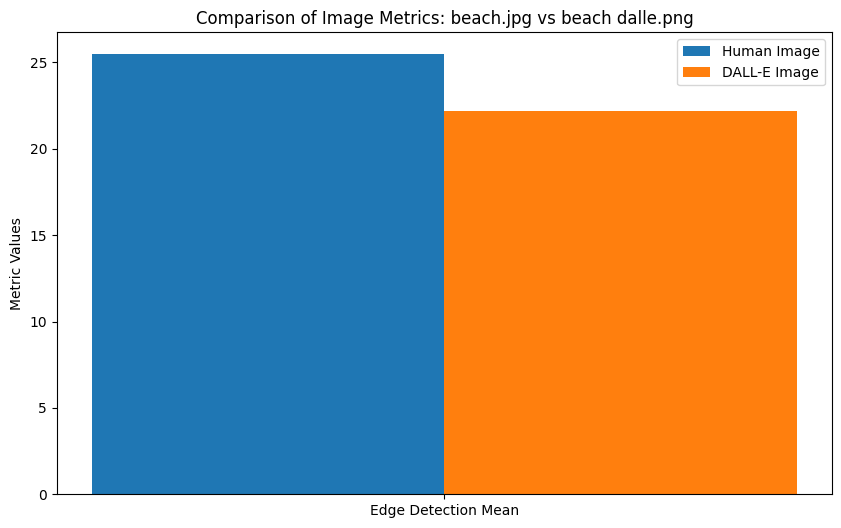

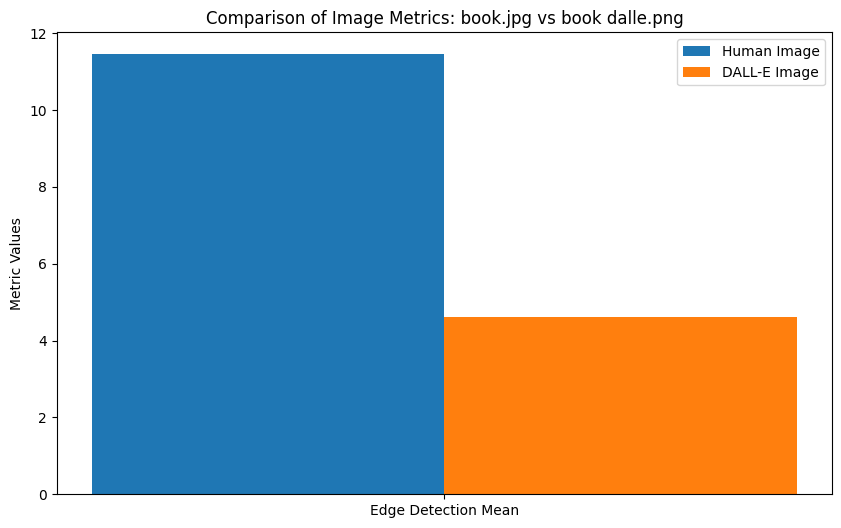

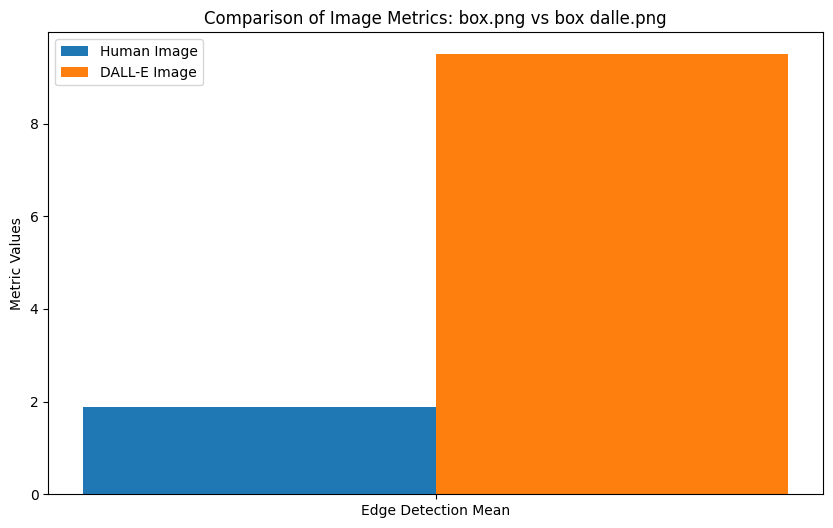

...

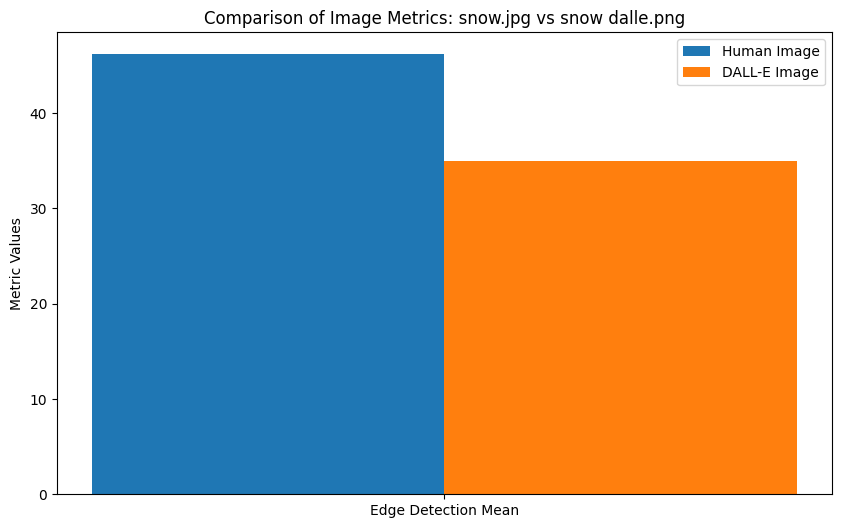

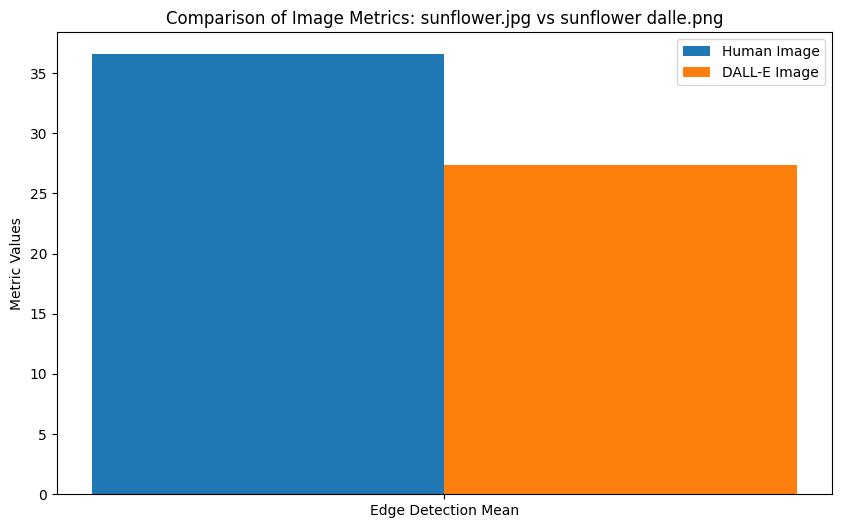

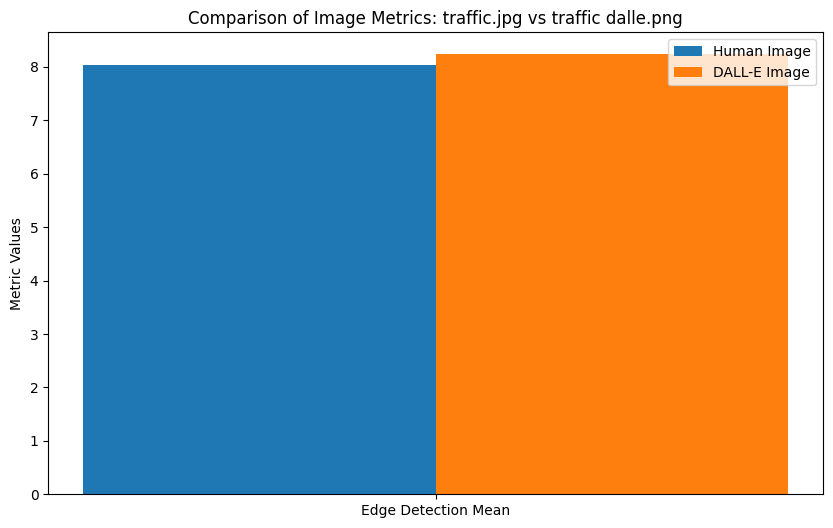

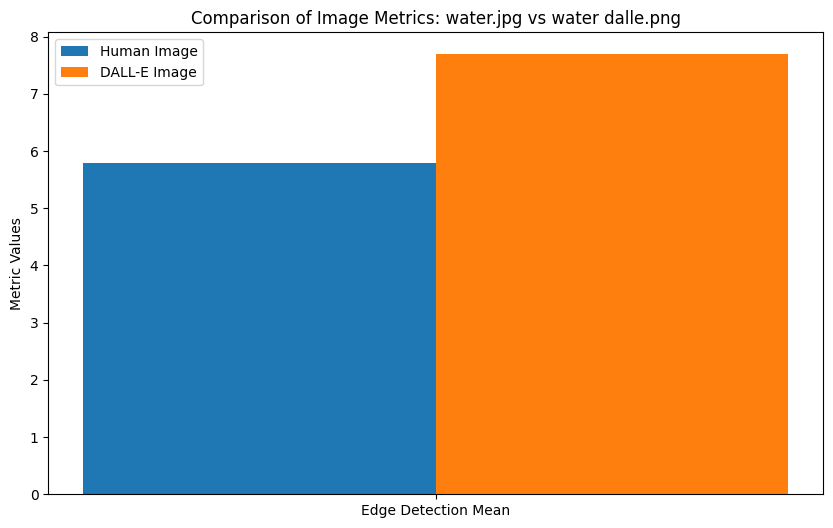

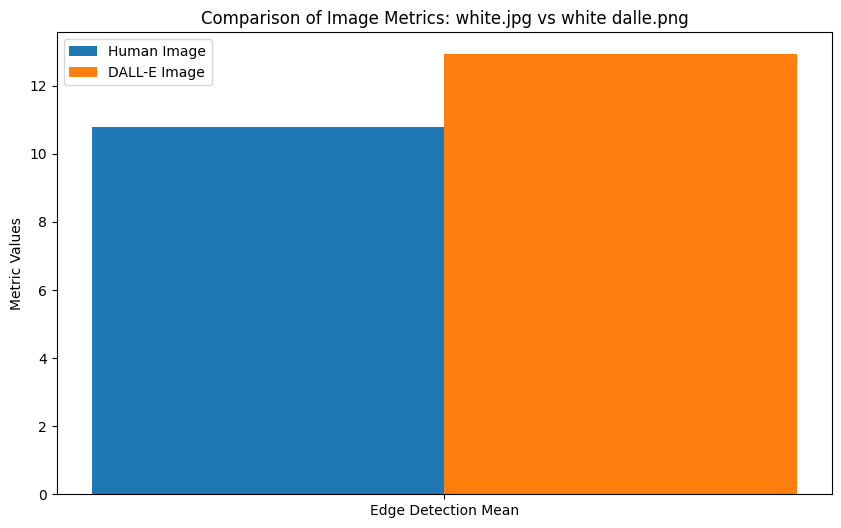

In [15]:


# Iterate over each pair and perform analysis
for human_img_path, dalle_img_path in paired_images:

    # Apply Edge Detection
    human_edges = apply_edge_detection(human_img_path)
    dalle_edges = apply_edge_detection(dalle_img_path)
    human_edges_metric = np.mean(human_edges)
    dalle_edges_metric = np.mean(dalle_edges)


    # Collect all metrics
    metrics = {
        'Human Image': {

            'Edge Detection Mean': human_edges_metric,

        },
        'DALL-E Image': {

           'Edge Detection Mean': dalle_edges_metric,

        }
    }


    # Plot metrics comparison
    human_img_name = os.path.basename(human_img_path)
    dalle_img_name = os.path.basename(dalle_img_path)
    plot_metrics_comparison(metrics, human_img_name, dalle_img_name)


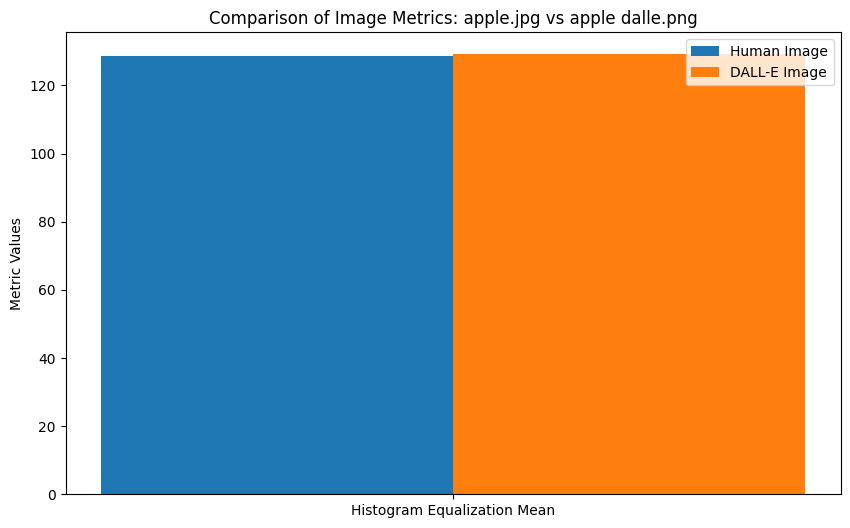

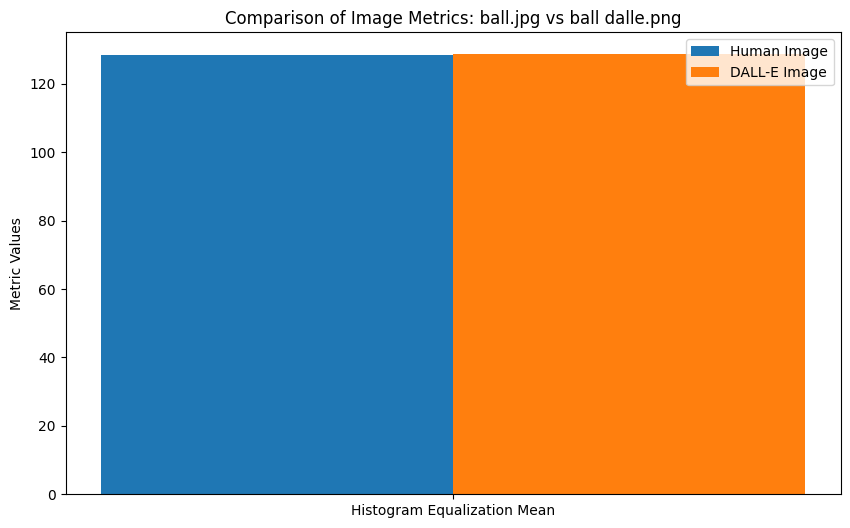

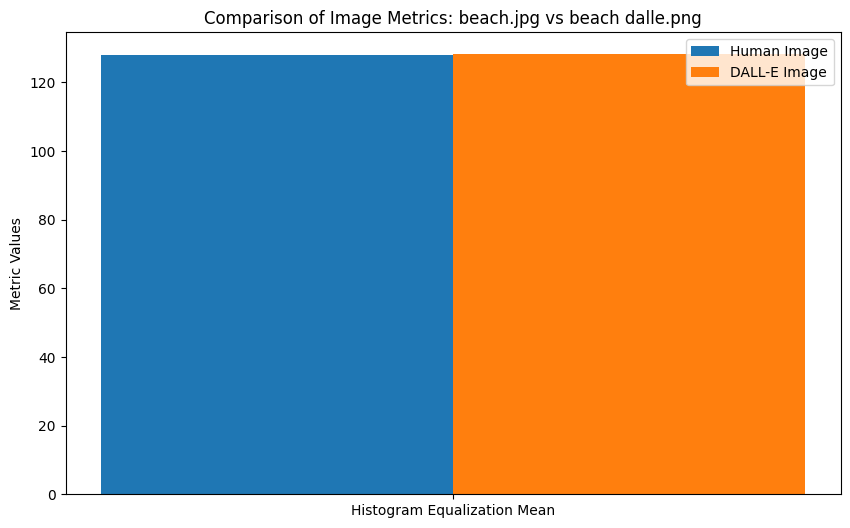

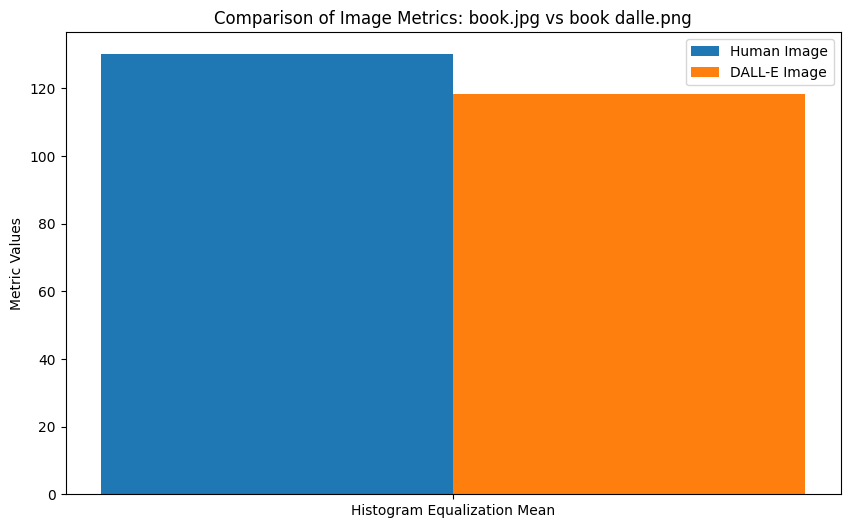

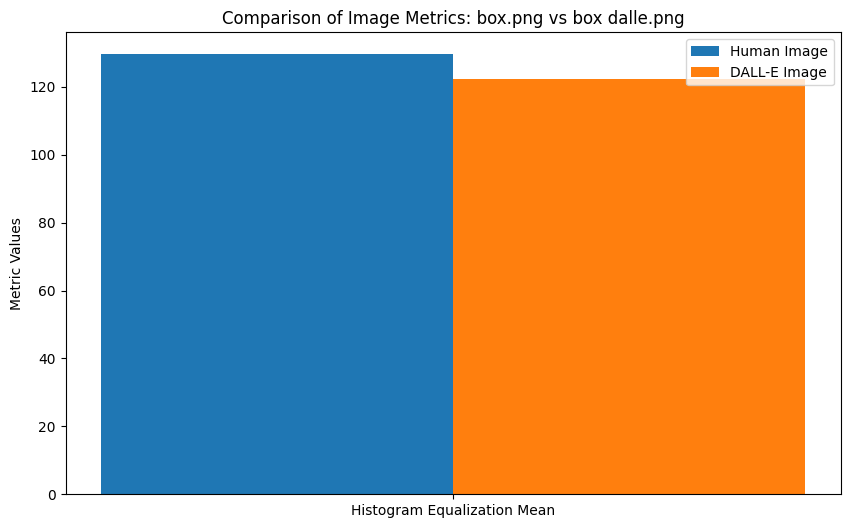

...

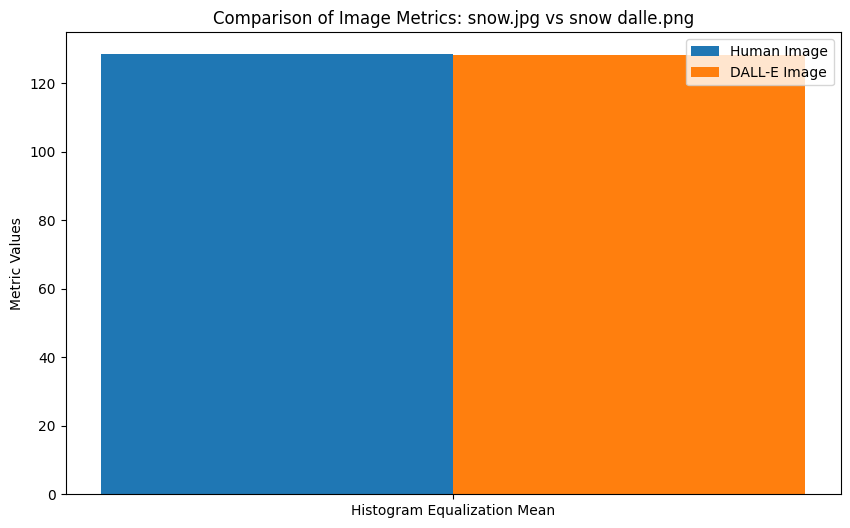

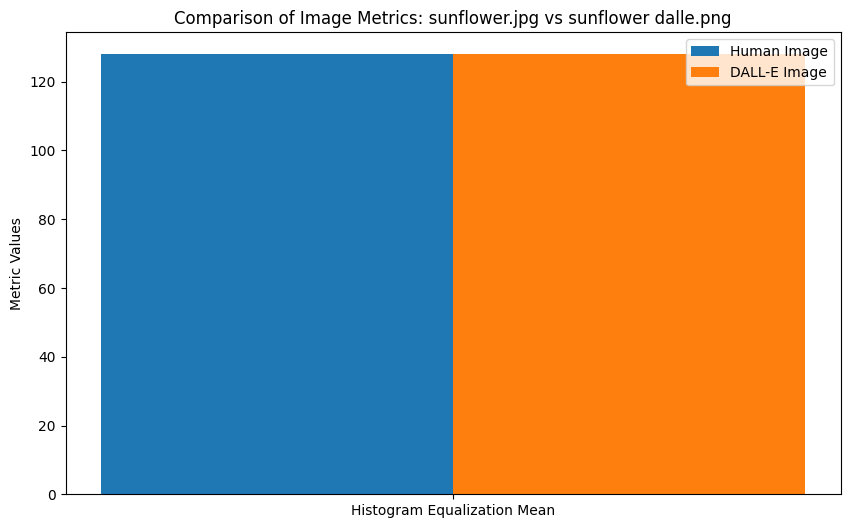

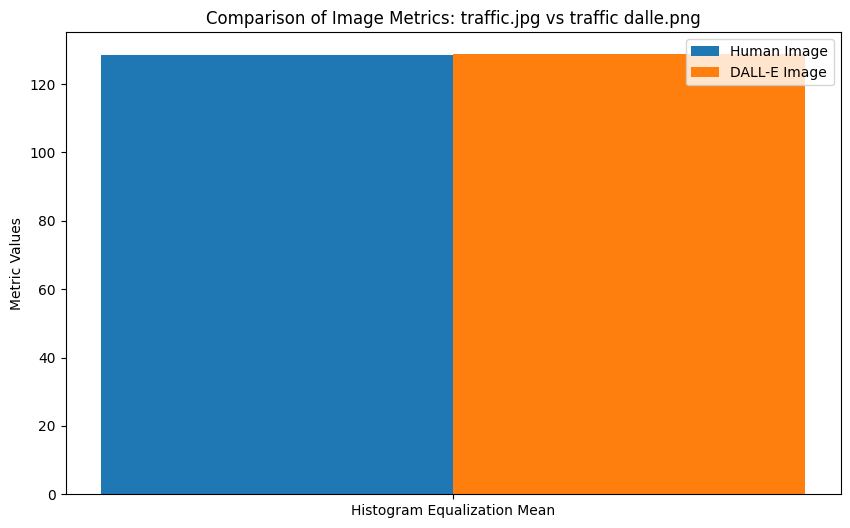

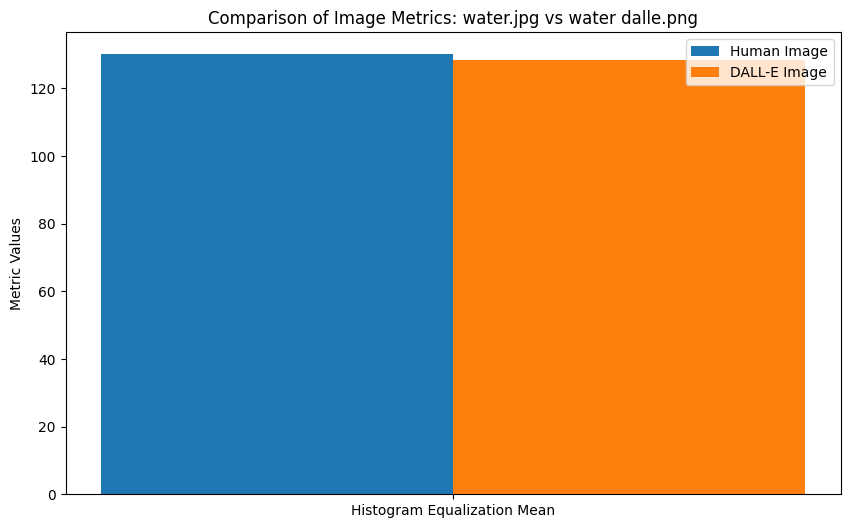

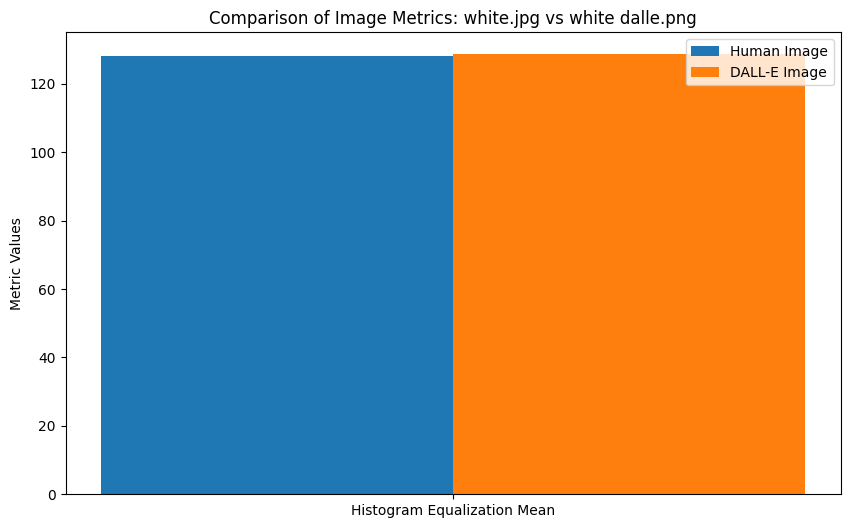

In [14]:
# Continue from the previous imports and functions

# Iterate over each pair and perform analysis
for human_img_path, dalle_img_path in paired_images:

    # Apply Histogram Equalization
    human_histogram_eq = apply_histogram_equalization(human_img_path)
    dalle_histogram_eq = apply_histogram_equalization(dalle_img_path)
    human_histogram_eq_metric = np.mean(human_histogram_eq)
    dalle_histogram_eq_metric = np.mean(dalle_histogram_eq)



    # Collect all metrics
    metrics = {
        'Human Image': {

            'Histogram Equalization Mean': human_histogram_eq_metric,

        },
        'DALL-E Image': {
           'Histogram Equalization Mean': dalle_histogram_eq_metric,

        }
    }


    # Plot metrics comparison
    human_img_name = os.path.basename(human_img_path)
    dalle_img_name = os.path.basename(dalle_img_path)
    plot_metrics_comparison(metrics, human_img_name, dalle_img_name)


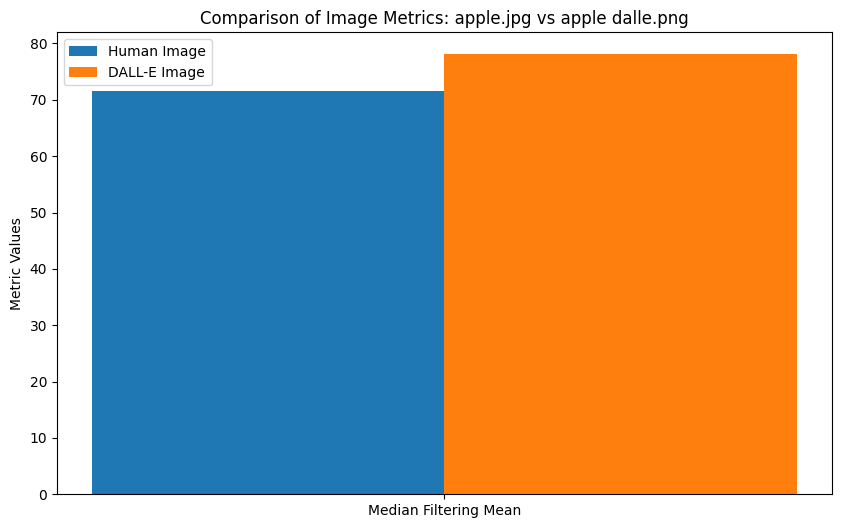

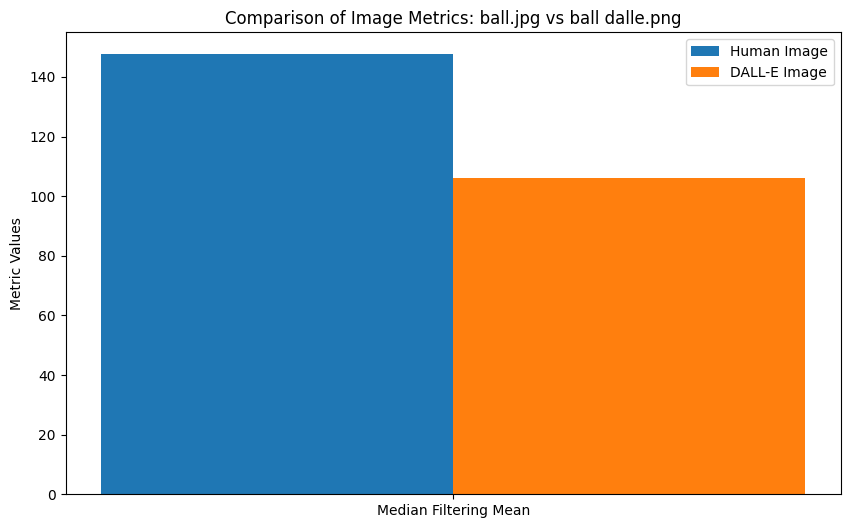

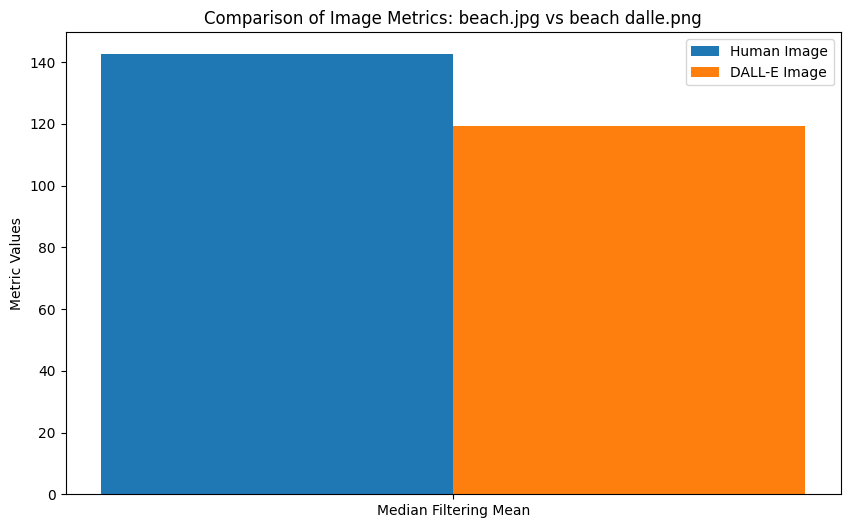

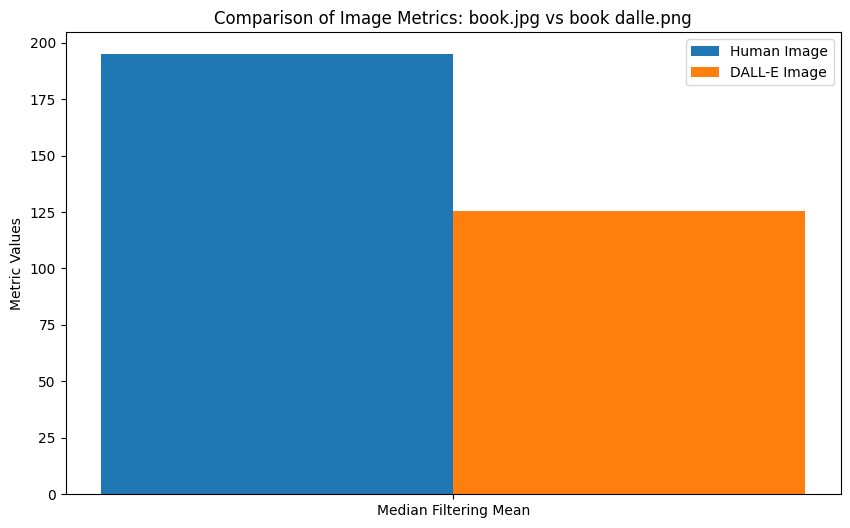

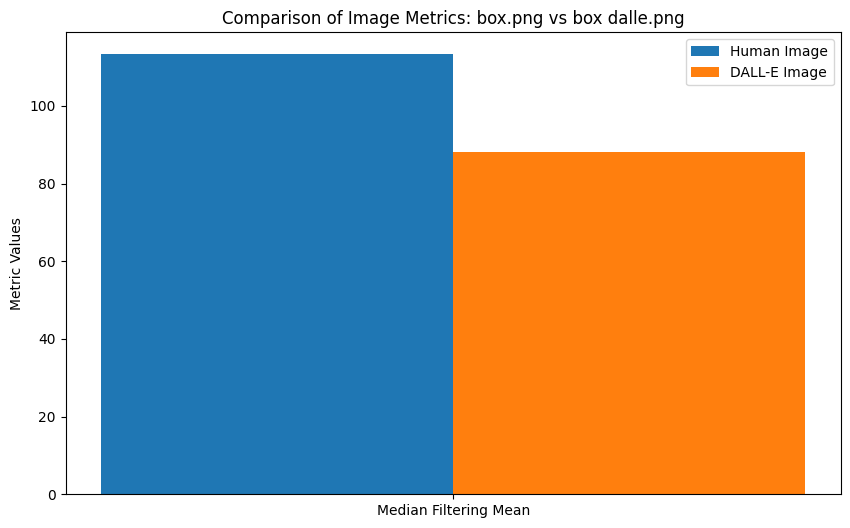

...

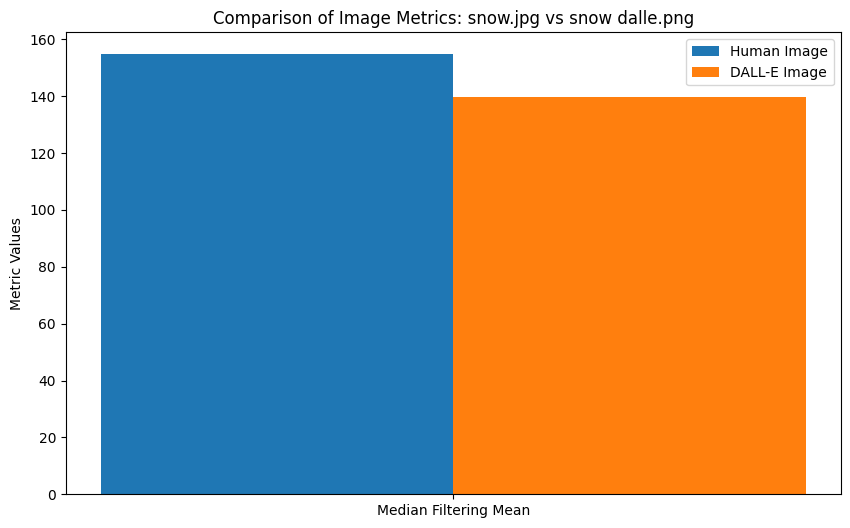

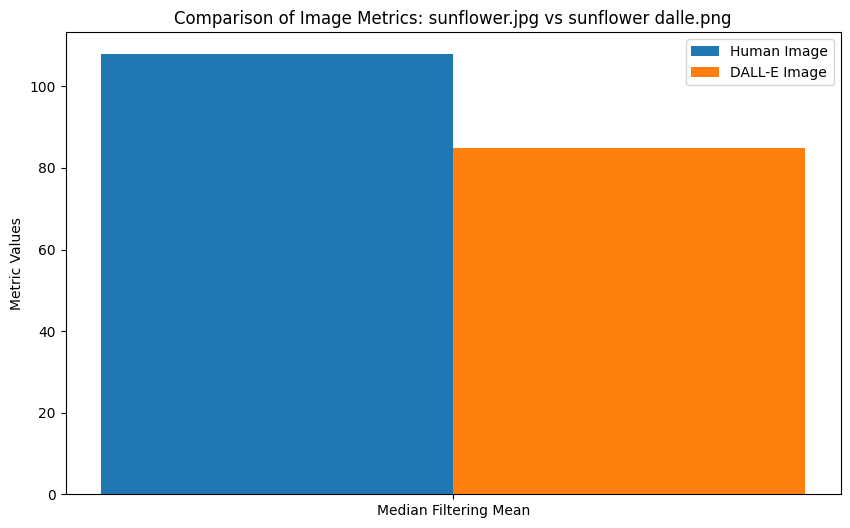

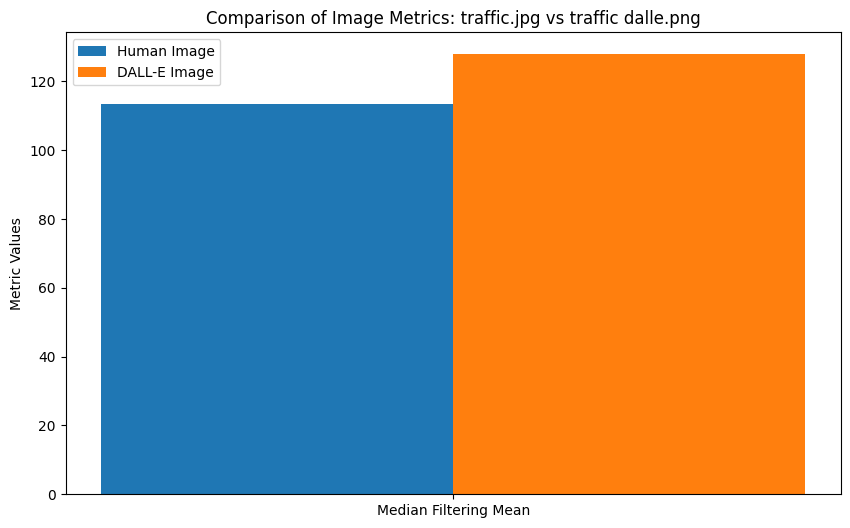

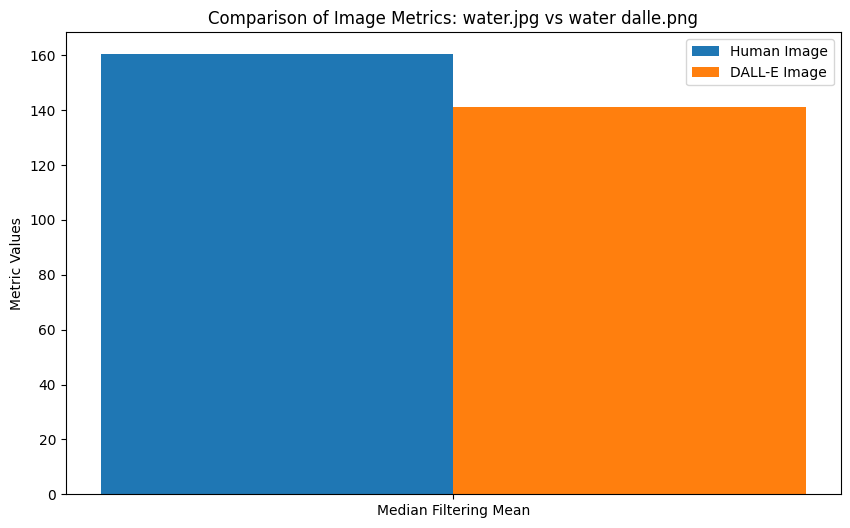

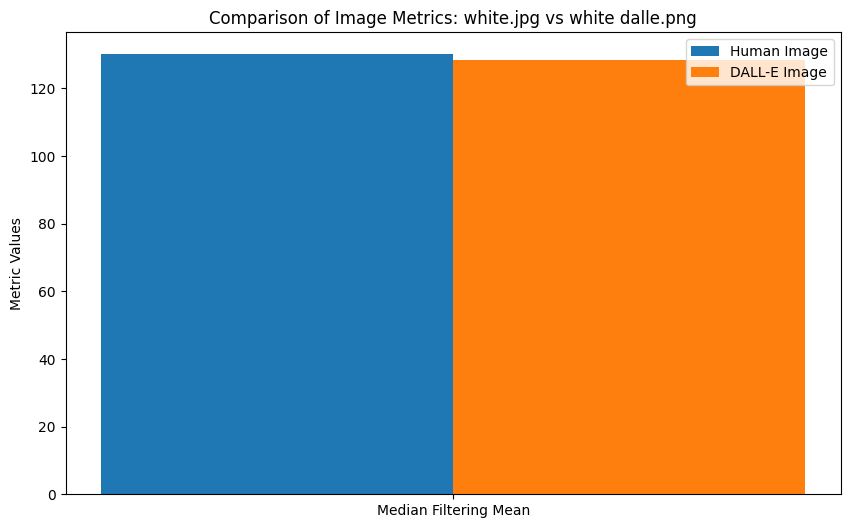

In [13]:

# Iterate over each pair and perform analysis
for human_img_path, dalle_img_path in paired_images:

    # Apply Median Filtering
    human_median = apply_median_filtering(human_img_path)
    dalle_median = apply_median_filtering(dalle_img_path)
    human_median_metric = np.mean(human_median)
    dalle_median_metric = np.mean(dalle_median)

    # Collect all metrics
    metrics = {
        'Human Image': {

            'Median Filtering Mean': human_median_metric
        },
        'DALL-E Image': {

           'Median Filtering Mean': dalle_median_metric
        }
    }


    # Plot metrics comparison
    human_img_name = os.path.basename(human_img_path)
    dalle_img_name = os.path.basename(dalle_img_path)
    plot_metrics_comparison(metrics, human_img_name, dalle_img_name)
